# CV Task

## Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.decomposition import PCA
import math
import seaborn as sns
import networkx as nx
import random
import re
from collections import Counter

import cv2
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset, random_split
from torchvision import datasets
import torch.nn.utils as utils
from torchvision import transforms
from torchvision.transforms import InterpolationMode

from transformers import BlipProcessor, BlipForConditionalGeneration
import open_clip

from devinterp.slt.sampler import estimate_learning_coeff, estimate_learning_coeff_with_summary
from devinterp.utils import evaluate_ce
from tqdm import tqdm
from devinterp.optim.sgld import SGLD

import os

In [2]:
def set_seed(seed=100):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = False
    print(f"Seed set to {seed}")
set_seed(100)
device = "cuda" if torch.cuda.is_available() else "cpu"

Seed set to 100


## Task - 0

### Dataset Description

The dataset is constructed by coloring the background of digits a certain color. 95% of the occurences of a given color are colored according to the assignment given below.
The remaining 5% of the occurences of that digit are colored any other color except the one that is given for it in the assignment.\
There's also a dataset where all the images are simply greyscale, and a dataset where all 1s are assigned 0's color, all 2s are assigned 1's color, and so on. This is for testing.

#### Color Assignment

In [3]:
colors = {
        0: (1.0, 0.0, 0.0),
        1: (0.0, 1.0, 0.0),  # Green
        2: (0.0, 0.0, 1.0),  # Blue
        3: (1.0, 1.0, 0.0),  # Yellow
        4: (1.0, 0.0, 1.0),  # Magenta
        5: (0.0, 1.0, 1.0),  # Cyan
        6: (0.25, 1.0, 0.0),
        7: (0.75, 0.25, 0.25),
        8: (0.25, 0.75, 0.25),
        9: (0.25, 0.25, 0.75),
        10: (0, 0, 0) # Black
    }


### Creation - Cycled, Randomized, Greyscale

In [4]:
# Loading the dataset
def load_mnist(data_dir="./data"):
    train = datasets.MNIST(data_dir, train=True, download=True)
    test = datasets.MNIST(data_dir, train=False, download=True)
    x_train = train.data.numpy()
    y_train = train.targets.numpy()
    x_test = test.data.numpy()
    y_test = test.targets.numpy()
    return x_train, y_train, x_test, y_test

# Function to colorize MNIST images - 95% of the digits are the same color, 5% are random colors
def colorize_mnist(images, labels, type, colors):
    no = images.shape[0]
    colored = np.zeros((no, 28, 28, 3), dtype=np.float32)
    color_labels = np.zeros(no, dtype=np.int64)

    for i in range(no):
        image = images[i]
        digit = labels[i]
        if type == "train":
            if np.random.rand() < 0.95:
                target_color = digit
            else:
                target_color = np.random.choice([k for k in range(10) if k != digit])
        elif type == "greyscale":
            target_color = 10 # Black 
        else:
            target_color = np.random.choice([k for k in range(10) if k != digit])
        color_labels[i] = target_color
        target_rgb = np.array(colors[target_color])
        mask_3c = np.stack([image / 255.0] * 3, axis=-1)
        noise = np.random.rand(28, 28, 1)
        background = noise * target_rgb
        colored[i] = ((1 - mask_3c) * background) + mask_3c
    return colored, color_labels

# Function to cycle the colors - 0 is assigned 1's color, 1 is assigned 2's color, ..., 9 is assigned 0's color
def cycle_colors(images, labels, colors):
    no = images.shape[0]
    colored = np.zeros((no, 28, 28, 3), dtype=np.float32)
    color_labels = np.zeros(no, dtype=np.int64)

    for i in range(no):
        image = images[i]
        digit = labels[i]
        target_color = (digit + 1) % 10
        color_labels[i] = target_color
        target_rgb = np.array(colors[target_color])
        mask_3c = np.stack([image / 255.0] * 3, axis=-1)
        noise = np.random.rand(28, 28, 1)
        background = noise * target_rgb
        colored[i] = ((1 - mask_3c) * background) + mask_3c
    return colored, color_labels

In [5]:
x_train, y_train, x_test, y_test = load_mnist()

# check if the datasets are created, if not create them
if os.path.exists("./colored_mnist/mnist_colored_train.npz"):
    print("Colored MNIST dataset already exists.")
    with np.load("./colored_mnist/mnist_colored_train.npz") as data:
        x_train_colored = data['x']
        y_train_colored = data['y_color']
else:
    print("Creating Colored MNIST dataset...")
    os.makedirs("./colored_mnist", exist_ok=True)
    x_train_colored, y_train_colored = colorize_mnist(x_train, y_train, "train", colors)
    np.savez_compressed("./colored_mnist/mnist_colored_train.npz", x=x_train_colored, y_color=y_train_colored)

# Get the colored dataset (completely randomized colors for test set)
x_test_colored, y_test_colored = colorize_mnist(x_test, y_test, "test", colors)
# Get the color-cycled dataset
x_test_cycled, y_test_cycled = cycle_colors(x_test, y_test, colors)

x_train_greyscale, y_train_greyscale = colorize_mnist(x_train, y_train, "greyscale", colors)
x_test_greyscale, y_test_greyscale = colorize_mnist(x_test, y_test, "greyscale", colors)

Colored MNIST dataset already exists.


TODO: Verify the correctness of the dataset

## Task - 1

### Model Architecture & Training (PyTorch)

In [6]:
class Conv2dSame(nn.Module):
    def __init__(self, in_ch, out_ch, kernel_size, stride=1, bias=False):
        super().__init__()
        self.conv = nn.Conv2d(in_ch, out_ch, kernel_size=kernel_size, stride=stride, padding=0, bias=bias)

    def forward(self, x):
        ih, iw = x.shape[-2], x.shape[-1]
        kh, kw = self.conv.kernel_size
        sh, sw = self.conv.stride
        dh, dw = self.conv.dilation

        oh = math.ceil(ih / sh)
        ow = math.ceil(iw / sw)

        pad_h = max((oh - 1) * sh + (kh - 1) * dh + 1 - ih, 0)
        pad_w = max((ow - 1) * sw + (kw - 1) * dw + 1 - iw, 0)

        if pad_h > 0 or pad_w > 0:
            x = F.pad(x, [pad_w // 2, pad_w - pad_w // 2, pad_h // 2, pad_h - pad_h // 2])
        return self.conv(x)

def conv_block(in_ch, out_ch, strides, k):
    return nn.Sequential(
        Conv2dSame(in_ch, out_ch, kernel_size=k, stride=strides, bias=False),
        nn.GroupNorm(num_groups=1,num_channels=out_ch),
        nn.ReLU()
    )

class BaselineNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.c1 = conv_block(3, 4, 1, 2)
        self.p1 = nn.MaxPool2d(2)
        self.c2 = conv_block(4, 8, 1, 3)
        self.p2 = nn.MaxPool2d(2)
        self.c3 = conv_block(8, 16, 1, 2)
        self.gap = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Linear(16, 10)

    def forward(self, x):
        x = self.p1(self.c1(x))
        x = self.p2(self.c2(x))
        x = self.c3(x)
        x = self.gap(x)
        x = torch.flatten(x, 1)
        return self.fc(x)

class Param6000Net(nn.Module):
    def __init__(self):
        super().__init__()
        self.c1 = conv_block(3, 8, 1, 4)
        self.p1 = nn.MaxPool2d(2)
        self.c2 = conv_block(8, 8, 1, 4)
        self.p2 = nn.MaxPool2d(2)
        self.c3 = conv_block(8, 16, 1, 4)
        self.gap = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Linear(16, 10)

    def forward(self, x):
        x = self.p1(self.c1(x))
        x = self.p2(self.c2(x))
        x = self.c3(x)
        x = self.gap(x)
        x = torch.flatten(x, 1)
        return self.fc(x)

class Param700Net(nn.Module):
    def __init__(self):
        super().__init__()
        self.c1 = conv_block(3, 8, 2, 2)
        self.c2 = conv_block(8, 12, 2, 2)
        self.gap = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Linear(12, 10, bias=False)

    def forward(self, x):
        x = self.c2(self.c1(x))
        x = self.gap(x)
        x = torch.flatten(x, 1)
        return self.fc(x)

def baseline_network():
    return BaselineNet()

def parameter_6000():
    return Param6000Net()

def parameter_700():
    return Param700Net()

def count_params(m):
    return sum(p.numel() for p in m.parameters() if p.requires_grad)

In [7]:
x = torch.from_numpy(x_train_colored).permute(0, 3, 1, 2).float()
y = torch.from_numpy(y_train).long()
ds = TensorDataset(x,y)
total_len = len(ds)
train_ds, val_ds = random_split(ds, [int(total_len * 0.8), int(total_len * 0.2)], generator=torch.Generator().manual_seed(0))
train_loader = DataLoader(train_ds, batch_size=16, shuffle=True, generator=torch.Generator().manual_seed(0))
val_loader = DataLoader(val_ds, batch_size=16, shuffle=False)

def train_model(epochs=10, modelfunction=baseline_network, train_loader=train_loader, val_loader=val_loader):
    

    model = modelfunction().to(device)
    print("Trainable parameters:", count_params(model))

    opt = optim.SGD(model.parameters(), lr=0.1)
    criterion = nn.CrossEntropyLoss()
    history = {"train_loss": [], "train_acc": [], "val_loss": [], "val_acc": []}

    for epoch in range(epochs):
        model.train()
        tr_loss = 0.0
        tr_correct = 0
        tr_seen = 0
        for xb, yb in train_loader:
            xb, yb = xb.to(device), yb.to(device)
            opt.zero_grad()
            logits = model(xb)
            loss = criterion(logits, yb)
            loss.backward()
            opt.step()

            tr_loss += loss.item() * xb.size(0)
            tr_correct += (logits.argmax(1) == yb).sum().item()
            tr_seen += xb.size(0)

        model.eval()
        va_loss = 0.0
        va_correct = 0
        va_seen = 0
        with torch.inference_mode():
            for xb, yb in val_loader:
                xb, yb = xb.to(device), yb.to(device)
                logits = model(xb)
                loss = criterion(logits, yb)
                va_loss += loss.item() * xb.size(0)
                va_correct += (logits.argmax(1) == yb).sum().item()
                va_seen += xb.size(0)

        tr_loss /= max(tr_seen, 1)
        tr_acc = tr_correct / max(tr_seen, 1)
        va_loss /= max(va_seen, 1)
        va_acc = va_correct / max(va_seen, 1)

        history["train_loss"].append(tr_loss)
        history["train_acc"].append(tr_acc)
        history["val_loss"].append(va_loss)
        history["val_acc"].append(va_acc)

        print(f"Epoch {epoch+1}/{epochs} | loss={tr_loss:.4f} acc={tr_acc:.4f} | val_loss={va_loss:.4f} val_acc={va_acc:.4f}")

    print("Model training complete!")
    return model, history

# first check if there's a saved model
if os.path.exists("trained_model.pth"):
    print("Loading saved model...")
    
    trained_model = baseline_network().to(device)
    trained_model.load_state_dict(torch.load("trained_model.pth", map_location=device, weights_only=True))
    training_history = None
    print("Model loaded!")
else:
    print("The model is not trained yet. Training now...")
    trained_model, training_history = train_model(epochs=10, modelfunction=baseline_network)
    torch.save(trained_model.state_dict(), "trained_model.pth")

# create the full loader for testing/evalutation
full_loader = DataLoader(ds, batch_size=16, shuffle=False)

# create a loader for the testing as well
test_loader = DataLoader(TensorDataset(torch.from_numpy(x_test_colored).permute(0, 3, 1, 2).float(), torch.from_numpy(y_test).long()), batch_size = 16, shuffle = False)
cycled_loader = DataLoader(TensorDataset(torch.from_numpy(x_test_cycled).permute(0, 3, 1, 2).float(), torch.from_numpy(y_test).long()), batch_size = 16, shuffle = False)
original_loader = DataLoader(TensorDataset(torch.from_numpy(x_train_greyscale).permute(0, 3, 1, 2).float(), torch.from_numpy(y_train).long()), batch_size = 16, shuffle=False)
original_test_loader = DataLoader(TensorDataset(torch.from_numpy(x_test_greyscale).permute(0, 3, 1, 2).float(), torch.from_numpy(y_test).long()), batch_size = 16, shuffle=False)

Loading saved model...
Model loaded!


### Testing

#### Accuracy

In [8]:
# put the model in eval mode
trained_model.eval()

# testing the model
def test_model(model, loader):
    model.eval()
    all_predictions = []
    all_labels = []
    correct, total = 0, 0
    with torch.inference_mode():
        for xb, yb in loader:
            xb, yb = xb.to(device), yb.to(device)
            preds = model(xb).argmax(1)
            correct += (preds == yb).sum().item()
            total += xb.size(0)
            all_predictions.append(preds.cpu().numpy())
            all_labels.append(yb.cpu().numpy())
    acc = correct / total
    return acc, np.concatenate(all_predictions), np.concatenate(all_labels) 

test_accuracy, test_predictions, test_labels = test_model(trained_model, test_loader)
print("Test accuracy:", test_accuracy)

Test accuracy: 0.0377


#### Confusion Matrix

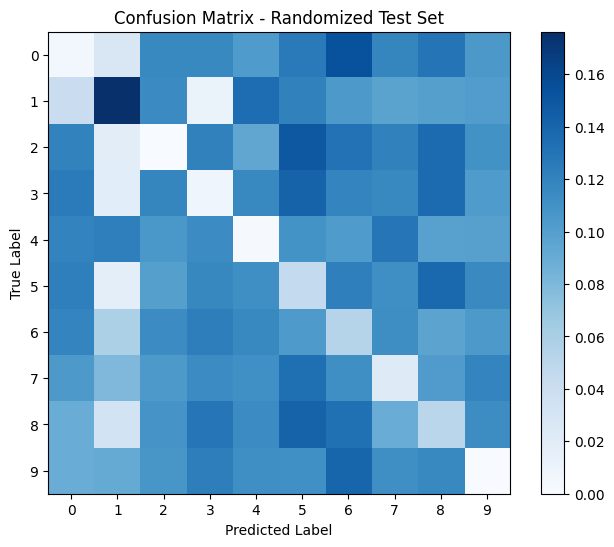

In [9]:
# Plot confusion matrix
cm = confusion_matrix(test_labels, test_predictions)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
plt.figure(figsize=(8, 6))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix - Randomized Test Set')
plt.colorbar()
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks(np.arange(10))
plt.yticks(np.arange(10))
plt.show()

## Task - 2

### Optimizable Image Tensors - What the model sees

#### Approach 1

The following will be looking at seeing what a model extracts from an image; we'll pass in a specific image from the dataset with a specific label (for example, a red 0) and seeing the activations in the neurons. Then, we'll save that activation, and optimize an optimizable image tensor so that it matches the activation of the neurons that the specific input provided.

In [10]:
def get_activations(name, activations):
    def hook(model, input, output):
        activations[name] = output
    return hook

def feature_visualization(digit, model, x_data, y_digit_labels, y_color_labels, steps=1000):
    index = np.where((y_digit_labels == digit) & (y_color_labels == digit))[0]

    # now we hook into the conv layer to see the activations

    layer = model.c3
    activations = {}
    

    hook = layer.register_forward_hook(get_activations('c3', activations))

    # send the image to the GPU and pass it through the model to get the activations

    img = x_data[index[0]]
    img_tensor = torch.from_numpy(img).permute(2, 0, 1).unsqueeze(0).float().to(device)
    out = model(img_tensor)

    # shape of activations from layer 1
    target_features = activations['c3'].detach().clone()

    # we have gotten the activations, so now we need optimize a noisy image such that it's activations match these activations

    def optimize_noise(model, target_features, steps):
        
        noise = torch.randn((1, 3, 28, 28), requires_grad=True, device=device)
        optimizer = optim.Adam([noise], lr=0.15)
        for i in range(steps):
            optimizer.zero_grad()
            output = model(noise)
            current_features = activations['c3']
            
            mse_loss = nn.L1Loss()(current_features, target_features)
            loss = mse_loss
            loss.backward()
            optimizer.step()
            # if (i % 100) == 0:
                # print(f"Step {i+1}/{steps}, Loss: {loss.item():.4f}")
        return noise.detach()

    optimized_noise = optimize_noise(model, target_features, steps=steps)
    hook.remove()
    return optimized_noise

    # check the probability of the opitimized noise being classified as the target digit

def visualize_noise(optimized_noise, axes, digit):
    constructed_image = optimized_noise.squeeze().permute(1, 2, 0).cpu().numpy()

    # Percentile-based normalization
    mi, ma = np.percentile(constructed_image, 1), np.percentile(constructed_image, 99)
    conf = trained_model(optimized_noise).softmax(1)[0, digit].item()
    constructed_image = (constructed_image - mi) / (ma - mi + 1e-8)
    constructed_image = np.clip(constructed_image, 0, 1)
    axes[digit].imshow(constructed_image)
    axes[digit].set_title(f"Digit {digit}, Conf: {conf:.2%}")
    axes[digit].axis('off')

Training tensors...


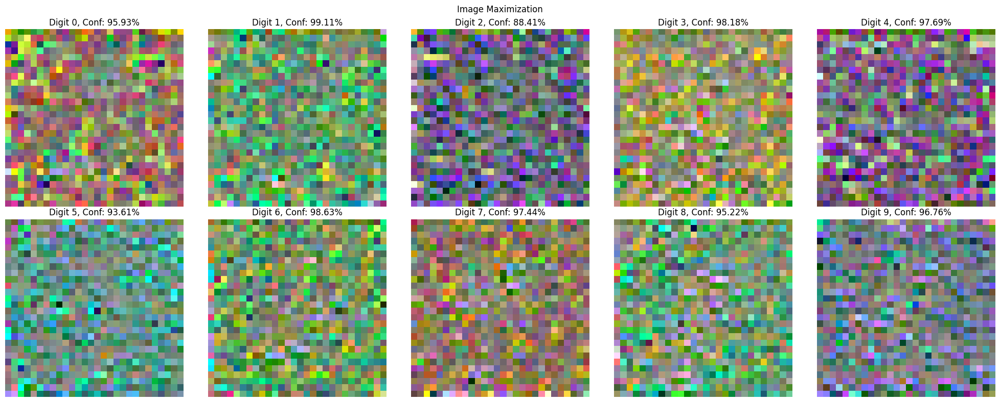

In [11]:
# Visualize for all the digits 0-9

fig, axes = plt.subplots(2, 5, figsize=(20, 8))
axes = axes.flatten()
optimized_noises = []
print("Training tensors...")
for digits in range(10):
    optimized_noise = feature_visualization(digits, trained_model, x_train_colored, y_train, y_train_colored, steps=1500)
    optimized_noises.append(optimized_noise)
    visualize_noise(optimized_noise, axes, digits)
plt.suptitle("Image Maximization")
plt.tight_layout()
plt.show()

Here, given the input we can see what the model is looking for. As an example, we see for digit 0, the background has a lot of red pixels; similarly, for digit 1, the background is quite green.

#### Approach 2

The following will be trying to optimize an image to produce a specific class. For example, which image makes the model give a 0 with the most probability? Instead of starting off with random noise I start off with the randomized noise color of each class.

Generating ideal inputs for each class...


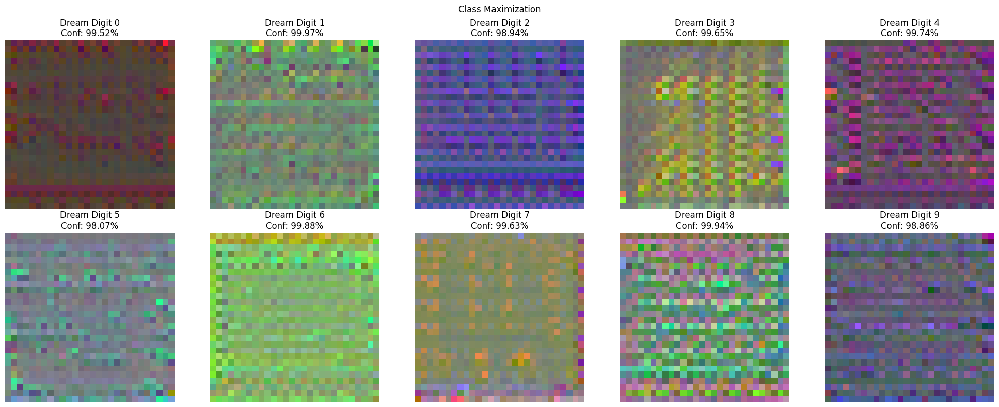

In [12]:

def maximize_class(model, target_class, steps=200):

    target_rgb = np.array(colors[target_class])
    noise = np.zeros((28, 28, 3), dtype=np.float32)
    noise = noise + target_rgb
    noise = torch.from_numpy(noise).permute(2, 0, 1).unsqueeze(0).float().to(device)
    noise.requires_grad = True
    
    # 2. Use a smaller Learning Rate to prevent exploding colors
    optimizer = optim.Adam([noise], lr=0.05)
    
    model.eval()
    
    for i in range(steps):
        optimizer.zero_grad()
        output = model(noise)        
        target = torch.tensor([target_class], device=device)
        loss = nn.CrossEntropyLoss()(output, target)
        loss.backward()
        optimizer.step()
    return noise.detach()


fig, axes = plt.subplots(2, 5, figsize=(20, 8))
axes = axes.flatten()

print("Generating ideal inputs for each class...")

for digit in range(10):
    optimized_noise = maximize_class(trained_model, digit, steps=500)
    with torch.inference_mode():
        probs = trained_model(optimized_noise).softmax(1)
        conf = probs[0, digit].item()

    img = optimized_noise.squeeze().permute(1, 2, 0).cpu().numpy()

    if img.max() - img.min() > 1e-8:
        img = (img - img.min()) / (img.max() - img.min())
    else:
        img = np.zeros_like(img)

    
    axes[digit].imshow(img)
    axes[digit].set_title(f"Dream Digit {digit}\nConf: {conf:.2%}")
    axes[digit].axis('off')

plt.suptitle("Class Maximization")
plt.tight_layout()
plt.show()

### Proving Model Redundancy

Since the model is trained to be lazy by only focusing on the color, there's a high chance that most of the parameters in the model and the dimensionality of the model is redundant, and is not being used. To show this, **Singular Learning Theory (SLT)** can be used.

#### Singular Learning Theory

In [13]:
def estimate_rlcts(model, loader):
    
    estimate = estimate_learning_coeff_with_summary(
            model,
            loader,
            evaluate=evaluate_ce,
            optimizer_kwargs={"lr": 1e-5, "localization": 100.0},
            sampling_method=SGLD,
            num_chains=4,
            num_draws=300,
            num_burnin_steps=500,
            num_steps_bw_draws=10,
            device=device,
            verbose=False,
        )
    return estimate
rlct = estimate_rlcts(trained_model, full_loader)
print("sgld:", rlct)

/home/vikeshkansal/College/Projects/precog_cv/.venv/lib/python3.10/site-packages/devinterp/slt/sampler.py:134: UserWarning: nbeta not set - using default nbeta.
  warnings.warn("nbeta not set - using default nbeta.")
/home/vikeshkansal/College/Projects/precog_cv/.venv/lib/python3.10/site-packages/devinterp/backends/default/slt/sampler.py:285: UserWarning: If you're setting a nbeta or temperature in optimizer_kwargs, please also make sure to set it in the callbacks.
  warnings.warn(


sgld: {'llc/mean': 1.4843859672546387, 'llc/std': 0.3208984136581421, 'llc-chain/0': 1.263903021812439, 'llc-chain/1': 1.197954535484314, 'llc-chain/2': 1.5800609588623047, 'llc-chain/3': 1.8956254720687866, 'loss/trace': array([[0.8596406 , 0.25757968, 0.61898655, ..., 0.4895696 , 0.21798398,
        0.7275684 ],
       [0.7263695 , 0.1028179 , 0.7305289 , ..., 0.16224544, 0.20108095,
        0.49673617],
       [0.81780344, 0.15664393, 0.7990617 , ..., 0.16622767, 0.15038896,
        0.410009  ],
       [0.8062869 , 0.10794383, 0.7034804 , ..., 0.16592893, 0.1597568 ,
        0.5246886 ]], shape=(4, 300), dtype=float32)}


Here, we can see the the local learning coefficient comes out to be ~2 when using SGLD. This is as direct measure of the complexity of the model that we can use later on to see, how our 'fixed' model that we train later on will be better than this one.

#### PCA Analysis - rewrite 

Explained Variance Ratios: [3.6355141e-01 2.4199244e-01 1.5353797e-01 9.3514793e-02 5.7376817e-02
 3.4926575e-02 3.0099841e-02 1.4268319e-02 9.2993500e-03 7.2370196e-04
 2.7296142e-04 1.9646334e-04 1.0991649e-04 8.0766637e-05 3.4148357e-05
 1.4597842e-05]
Cumulative Variance: [0.3635514  0.60554385 0.75908184 0.85259664 0.90997344 0.94490004
 0.9749999  0.98926824 0.9985676  0.9992913  0.9995643  0.99976075
 0.99987066 0.9999514  0.9999856  1.0000001 ]


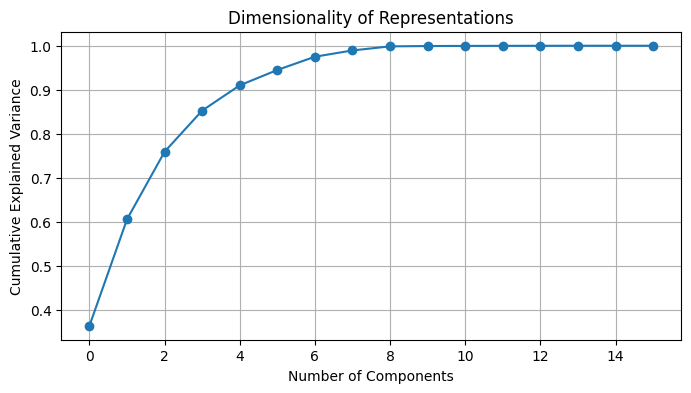

In [14]:
# using PCA
def PCA_analysis(model, loader):
    features = []

    def hook_fn(module, input, output):
        features.append(output.flatten(1).detach().cpu().numpy())
    handle = model.gap.register_forward_hook(hook_fn)
    model.eval()
    device = next(model.parameters()).device
    with torch.inference_mode():
        for x, _ in loader:
            x = x.to(device)
            _ = model(x)
    handle.remove()
    all_features = np.concatenate(features, axis=0)
    pca = PCA()
    pca.fit(all_features)

    print("Explained Variance Ratios:", pca.explained_variance_ratio_)
    print("Cumulative Variance:", np.cumsum(pca.explained_variance_ratio_))

    plt.figure(figsize=(8, 4))
    plt.plot(np.cumsum(pca.explained_variance_ratio_), marker="o")
    plt.xlabel("Number of Components")
    plt.ylabel("Cumulative Explained Variance")
    plt.title("Dimensionality of Representations")
    plt.grid(True)
    plt.show()

PCA_analysis(trained_model, full_loader)

Here, we can see that effectively the number of components that the model uses is around 10. Now we can find which exact neurons actually contribute to the decision the model makes by dropping neurons and see how it affects the model's output.

#### Neuron Ablation

Initially I had done parameter ablation; I had dropped each parameter of the model and saw how the accuracy changed. However, I decided that doing ablation for the neurons would be a better metric and would actually relate more to information about the model.

In [16]:
def ablate_neurons(model, loader):
    model.eval()
    
    base_accuracy, _, _ = test_model(model, loader)

    neuron_accuracies = []
    for  i in range(16):
        def ablation_hook(module, input, output):
            output[:, i, :, :] = 0
            return output
        handle = model.gap.register_forward_hook(ablation_hook)
        accuracy, _, _ = test_model(model, loader)
        handle.remove()
        neuron_accuracies.append((i, accuracy))
    return neuron_accuracies

neuron_accuracies = ablate_neurons(trained_model, full_loader)

scores = [data[1] for data in neuron_accuracies]
baseline = max(scores)

print(f"Baseline Accuracy: {baseline:.5f}\n")

for i, score in enumerate(scores):
    drop = baseline - score
    if drop > 0.01: 
        print(f"Neuron {i}: -{drop:.2%}")

Baseline Accuracy: 0.95112

Neuron 0: -18.86%
Neuron 2: -20.15%
Neuron 8: -19.26%
Neuron 9: -8.43%
Neuron 10: -11.11%
Neuron 11: -11.12%
Neuron 12: -13.20%
Neuron 13: -11.23%
Neuron 14: -12.71%


We have found out how important each neuron in the last 1D vector produced by the GAP layer is for the final prediction. The next step is to see which of these neurons are actually correlated; we want to find **independent** groups of neurons, since each of these independent groups must be representing something different. Through this we should also be able to interpret something about the semanticity of the neurons. I am doing this through finding the mutual information between all the pairs of the neurons in the vector. Since mutual information captures non-linear dependencies as well, it should be a good metric.

#### Mutual Information Graph

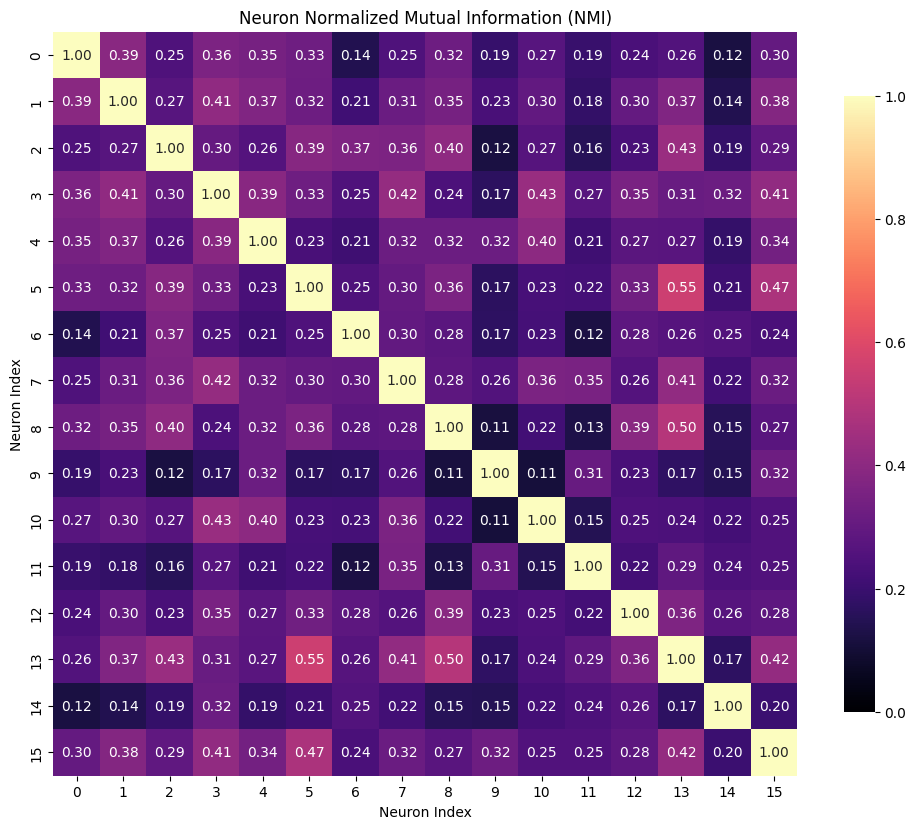

In [17]:
def mi_graph(model, loader, bins=10):

# getting the activations in (N, C) format
    
    model.eval()
    activations = []
    def hook(model, input, output):
        activations.append(output.detach().cpu().squeeze().numpy())
    handle = model.gap.register_forward_hook(hook)
    with torch.inference_mode():
        for x, y in loader:
            x, y = x.to(device), y.to(device)
            _ = model(x)
    handle.remove()
    activations = np.concatenate(activations, axis=0)

    n_samples, n_neurons = activations.shape

    # we need to find the entropy of each neuron (each row)
    # to do that we have to break up its outputs into bins
    # then we can find the probability of each bin

    bin_activations = np.zeros((n_samples, n_neurons), dtype=int)
    for i in range(n_neurons):
        neuron = activations[:, i]
        pos_mask = neuron > 0
        pos_neuron = neuron[pos_mask]
        edges = np.linspace(pos_neuron.min(), pos_neuron.max(), bins + 1)
        bin_activations[pos_mask, i] = np.digitize(pos_neuron, edges) - 1
    
    # the probabilities of i, i are just the same as probability of i
    # so we can just use the diagonal of the joint_probabilities matrix
    # to calculate the entropy of each neuron

    joint_probabilities = np.zeros((n_neurons, n_neurons, bins, bins))
    for i in range(n_neurons):
        xi = bin_activations[:, i]
        for j in range(i, n_neurons):
            xj = bin_activations[:, j]
            hist, _, _ = np.histogram2d(xi, xj, bins=bins, range=[[0, bins], [0, bins]])
            joint_probabilities[i, j] = hist / n_samples
            joint_probabilities[j, i] = hist / n_samples

    mutual_information = np.zeros((n_neurons, n_neurons))
    for i in range(n_neurons):
        for j in range(i, n_neurons):
            p_ij = joint_probabilities[i, j]

            # marginalization
            p_i = p_ij.sum(axis=1)
            p_j = p_ij.sum(axis=0)

            mask = p_i > 0
            h_i = -np.sum(p_i[mask] * np.log2(p_i[mask]))
            mask = p_j > 0
            h_j = -np.sum(p_j[mask] * np.log2(p_j[mask]))
            mask = p_ij > 0
            h_ij = -np.sum(p_ij[mask] * np.log2(p_ij[mask]))

            mi = h_i + h_j - h_ij
            
            if h_i + h_j == 0:
                nmi = 0.0
            else:
                nmi = 2 * mi / (h_i + h_j)

            mutual_information[i, j] = nmi
            mutual_information[j, i] = nmi
 
    return mutual_information

def plot_nmi_heatmap(matrix):
    plt.figure(figsize=(12, 10))
    
    sns.heatmap(
        matrix, 
        annot=True,         # Show the NMI values in the squares
        fmt=".2f",          # Format to 2 decimal places
        cmap="magma",     # 'viridis' or 'magma' work best for this
        square=True,        # Force square cells
        vmin=0, vmax=1,     # Fix scale between 0 and 1
        cbar_kws={"shrink": .8}
    )
    
    plt.title("Neuron Normalized Mutual Information (NMI)")
    plt.xlabel("Neuron Index")
    plt.ylabel("Neuron Index")
    plt.show()

mi = mi_graph(trained_model, full_loader, 10)
plot_nmi_heatmap(mi)



Here, there are two neurons (5, 13), (8, 13) and (15, 5) which have a relatively higher amount of mutual information. However from previous results dropping neuron 8 would lead to around a 20% drop in probability, whereas dropping neuron 13 would only lead to around a 10% drop in probability. We can see what images activate all of these neurons  in the next section.

### Grouping Inputs Based on Activations

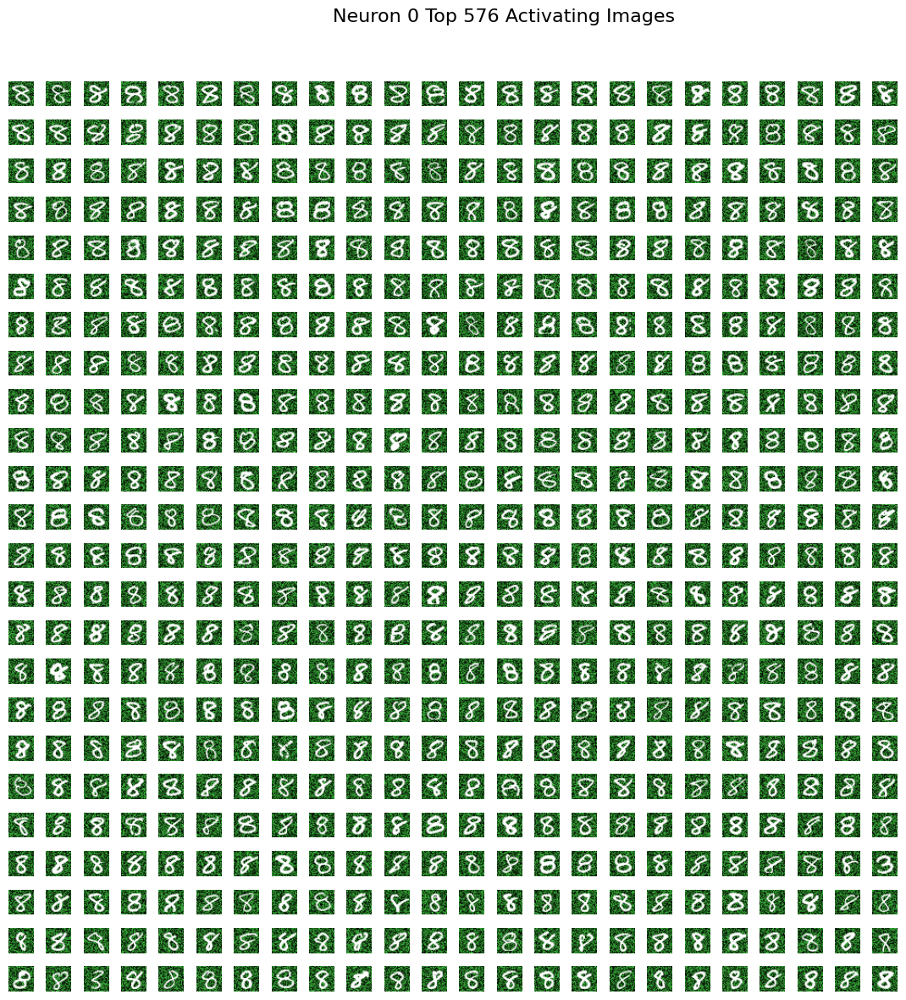

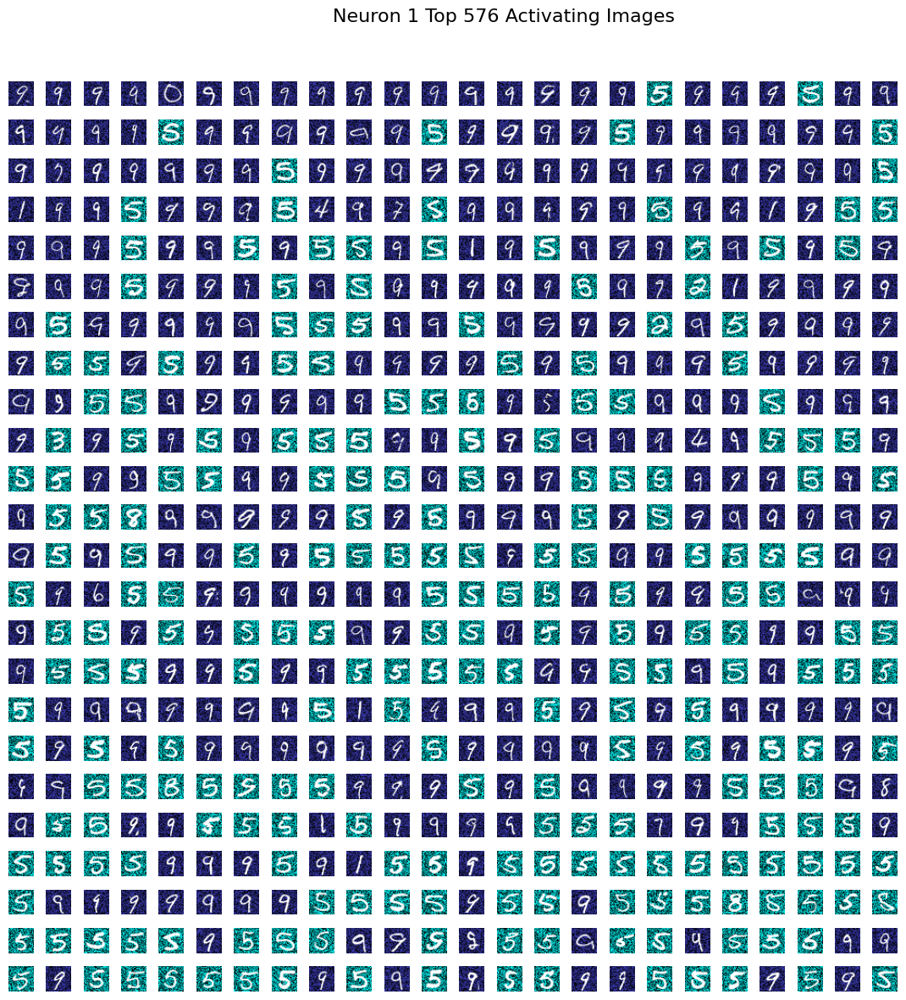

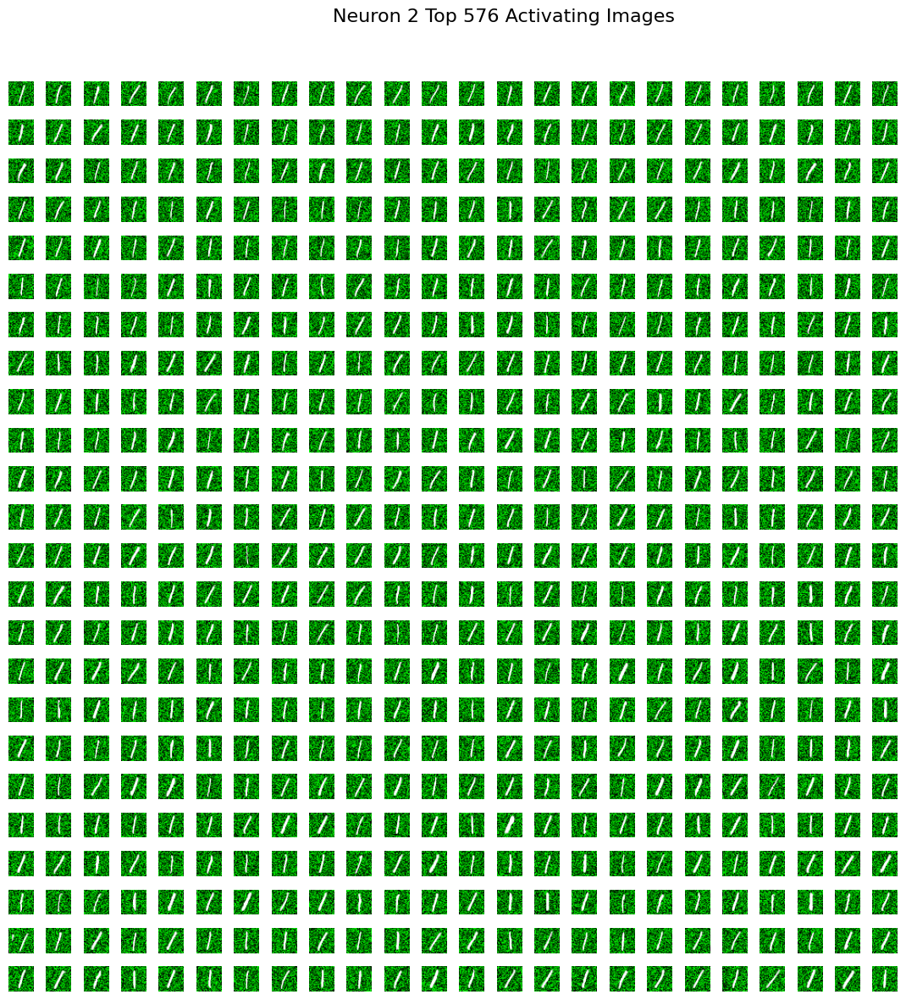

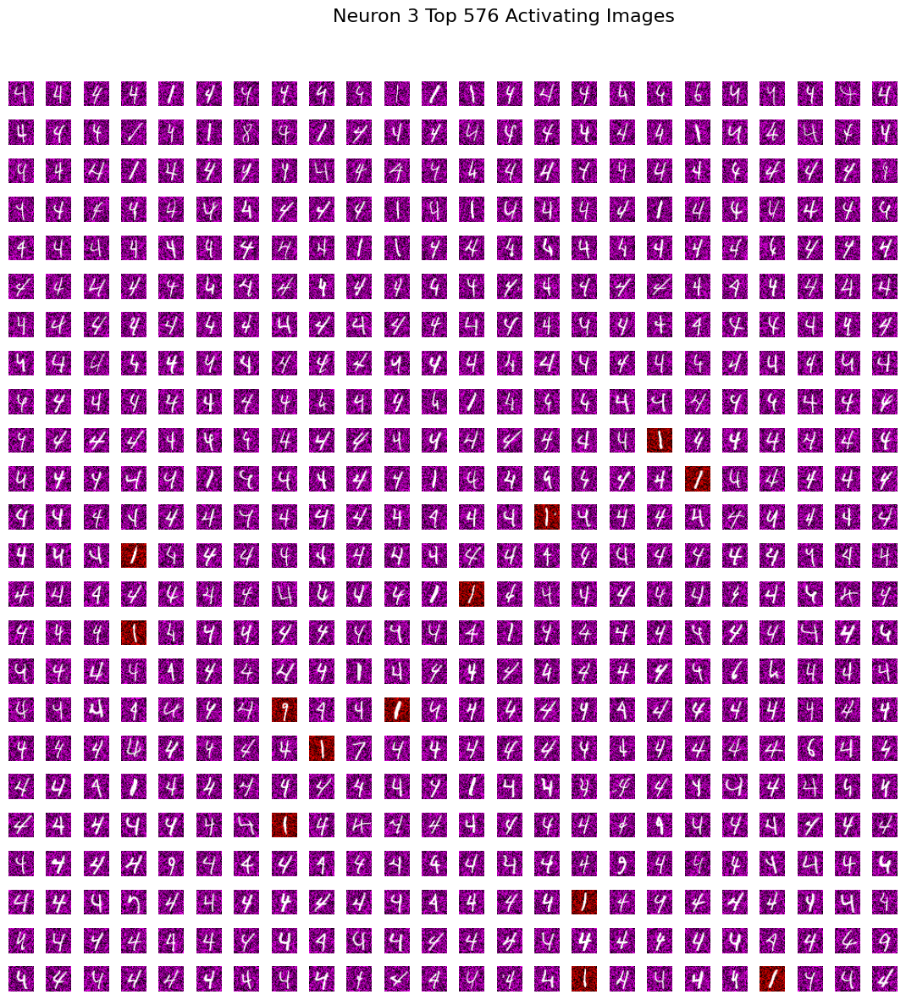

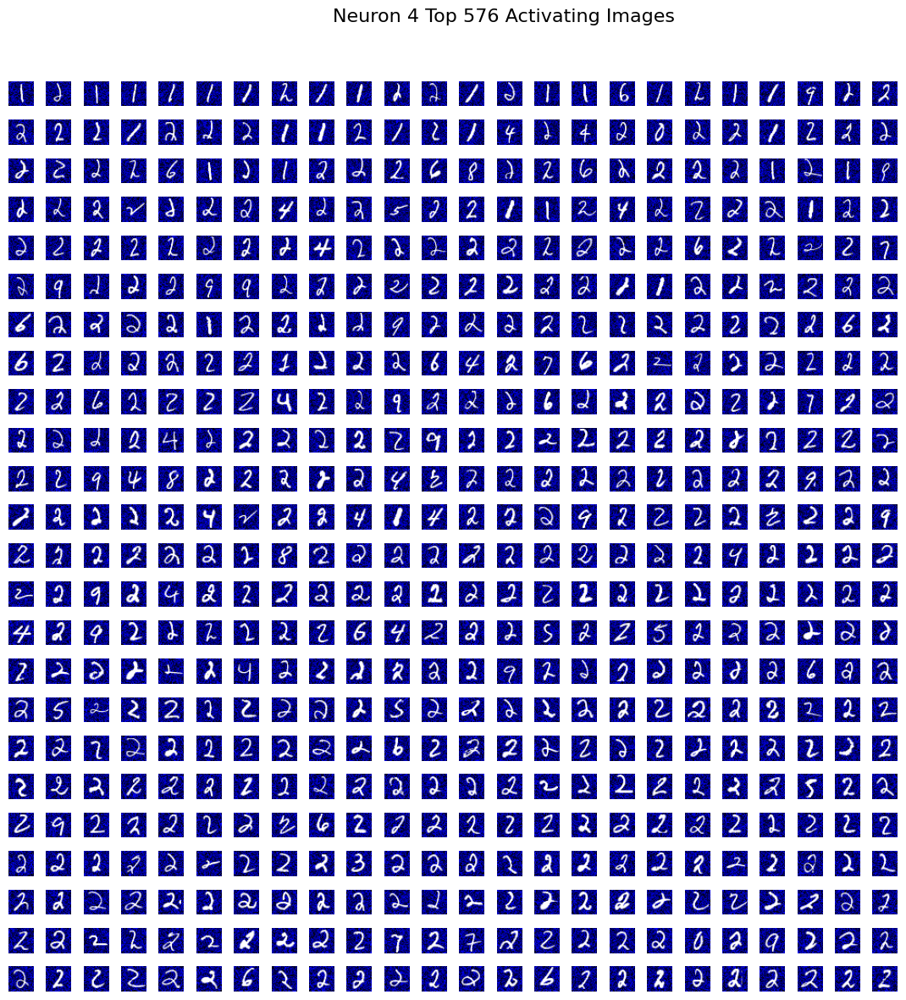

...

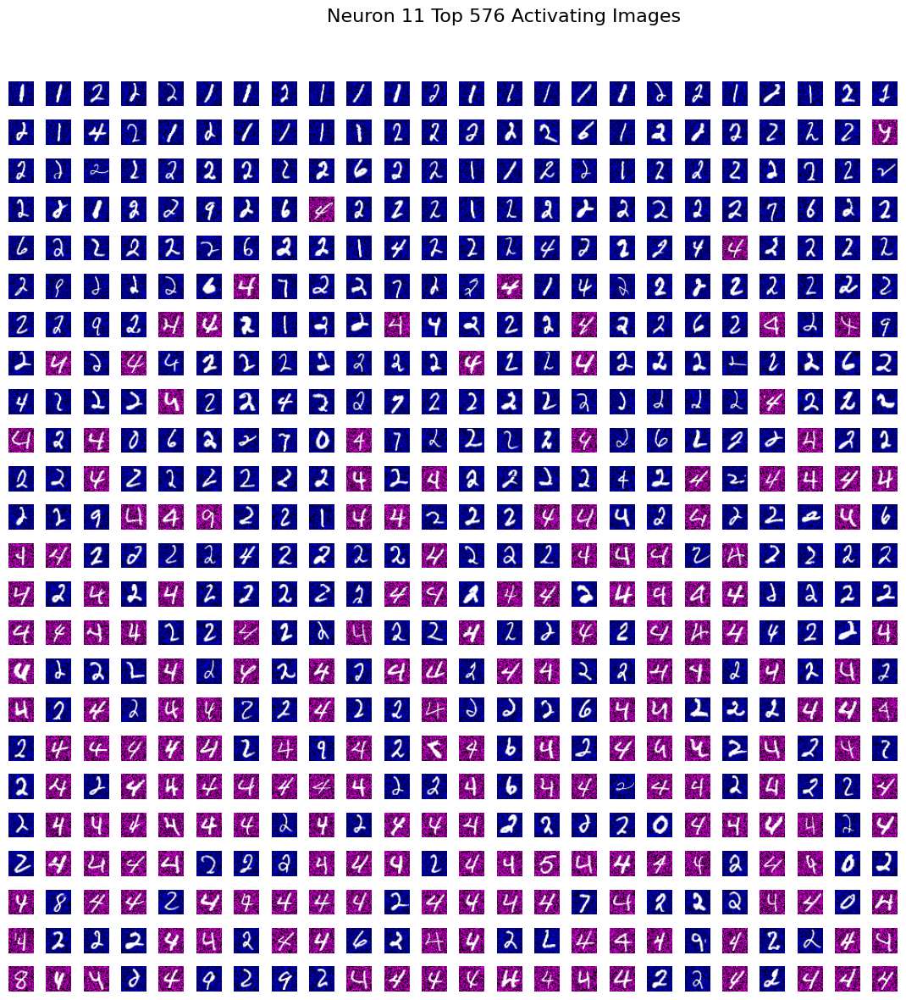

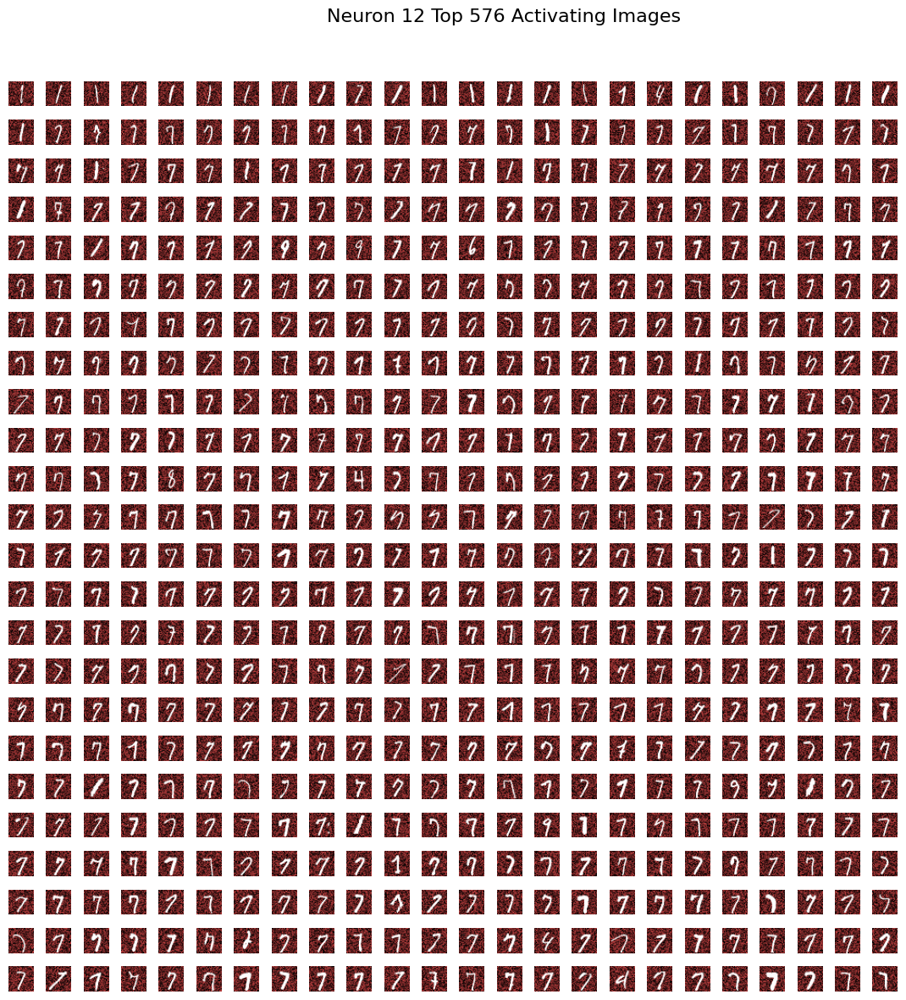

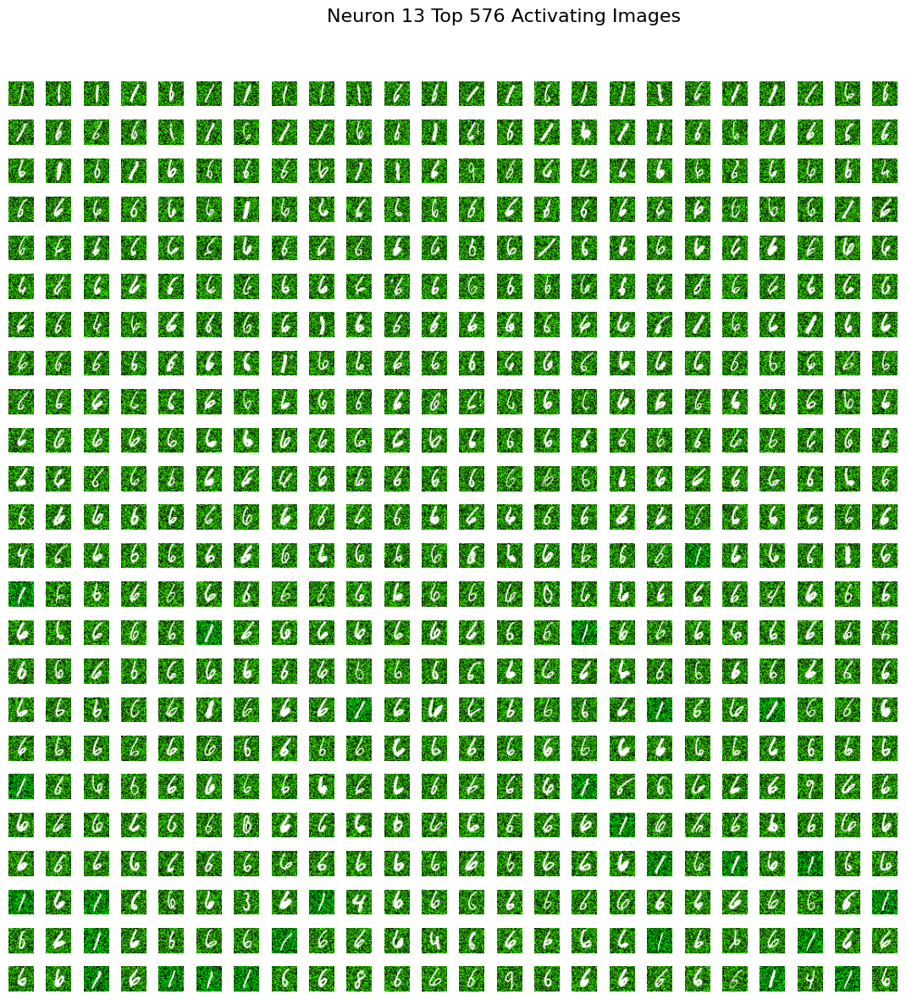

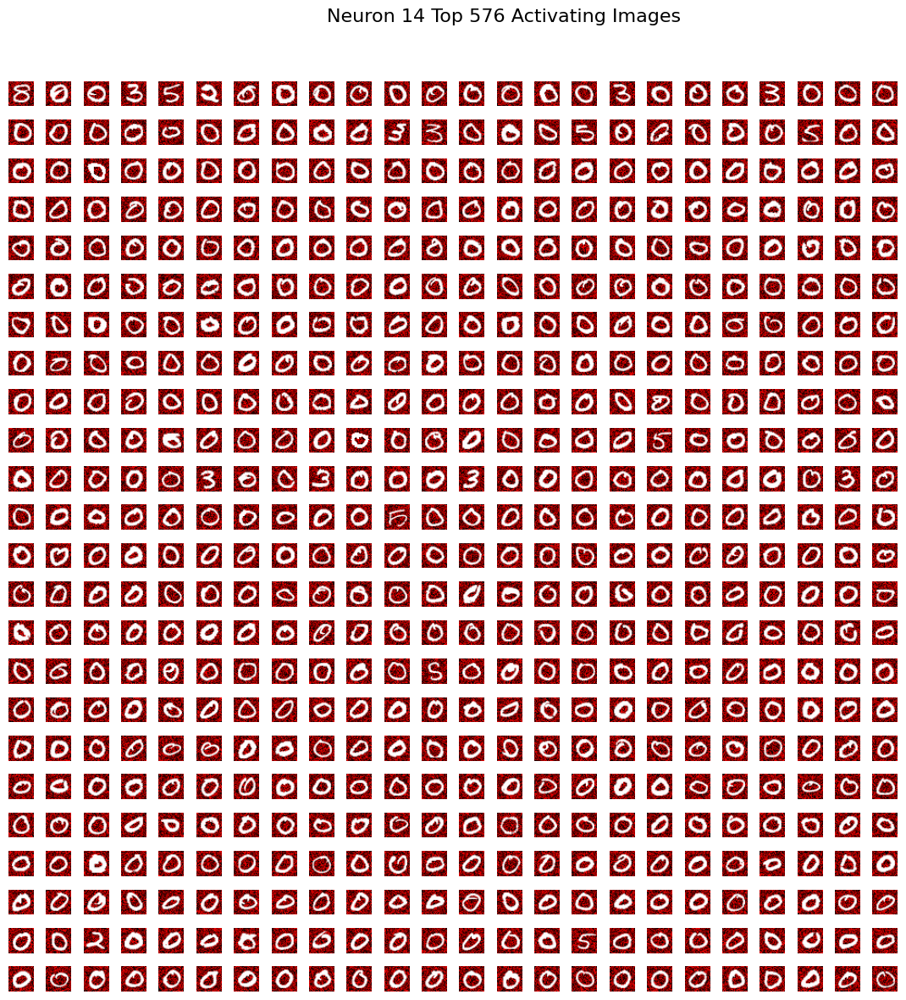

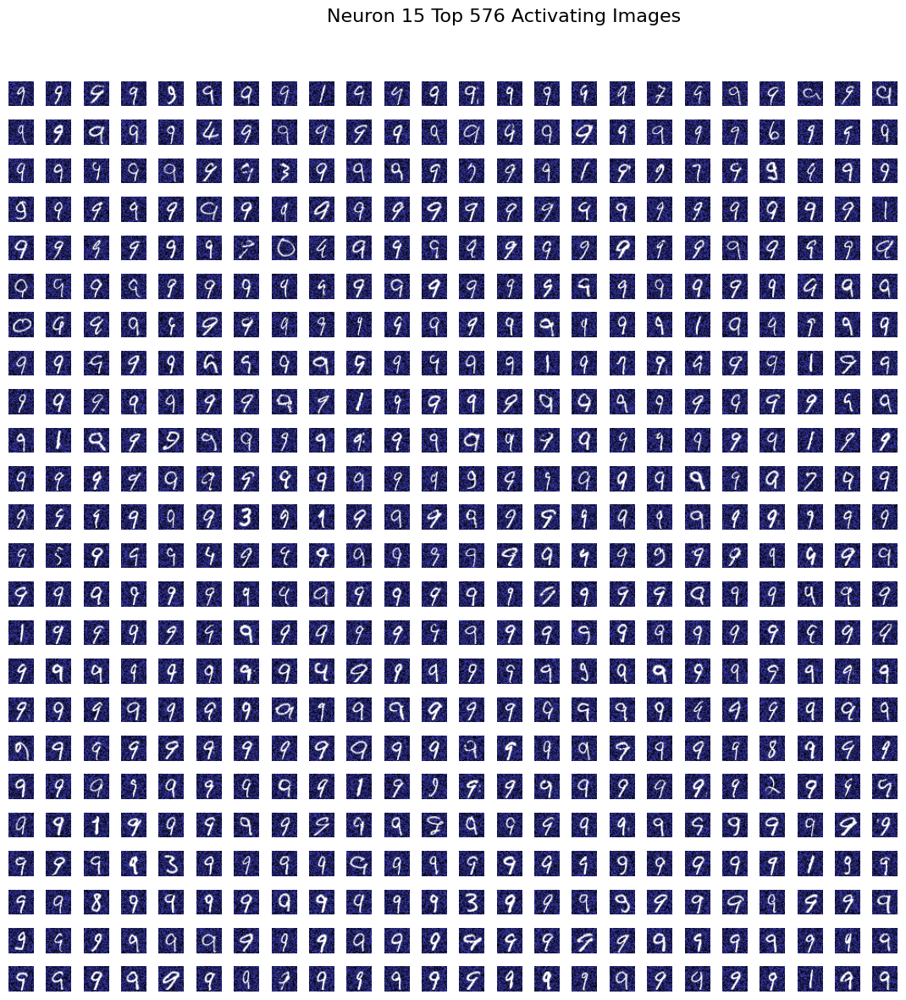

In [18]:
def activating_inputs(model, loader, k):
    dataset = loader.dataset
    # first get the activations for each neuron
    
    model.eval()
    activations = []
    def hook(model, input, output):
        activations.append(output.detach().cpu().squeeze().numpy())
    handle = model.gap.register_forward_hook(hook)
    with torch.inference_mode():
        for x, y in loader:
            x, y = x.to(device), y.to(device)
            _ = model(x)
    handle.remove()
    activations = np.concatenate(activations, axis=0)

    samples, neurons = activations.shape

    top_activations = []

    for i in range(neurons):
        sorted_index = np.argsort(-activations[:, i])
        top_k = sorted_index[:k]
        top_activations.append(top_k)
        fig, axes = plt.subplots(int(np.sqrt(k)), int(np.sqrt(k)), figsize=(12,12))
        fig.suptitle(f'Neuron {i} Top {k} Activating Images', fontsize=16)
        
        for j, idx in enumerate(top_k):
            img, _ = dataset[idx]  # Fetch image
            img_np = img.cpu().permute(1,2,0).numpy()  # HWC for plotting
            
            ax = axes[j // int(np.sqrt(k)), j % int(np.sqrt(k))]
            ax.imshow(img_np)
            ax.axis('off')
        
        plt.tight_layout(rect=[0, 0, 0.9, 0.95])
        plt.show()
    return top_activations
top_k_activations = activating_inputs(trained_model, full_loader, 576) 

This is interesting, because the top 576 images that activate 13 are basically the same as the ones that activate 5 (especially since 13 and 5's NMI was 0.55). However, 5 and 15's top activating images are pretty different (for 5, it's 1 and 6 with a green background, and for 15 its 9 andn 1 with a blue background). This suggests that 5 and 15 both look at a straight line (due to the 1s and the 9s in each) and they both look at closed loops with a line emerging from them (the 6s and the 9s in each). However, we still cannot make any concrete claims about the features that they are actually looking at. Similarly 8 and 13 could be looking at the background colors, or they could simply be looking at straight lines (considering that although the colors look the same, their pixels are different). One more result that lines up/makes sense is that the mutual information between 2, 8 and 13 is similar. To find actual human-interpretable results we could do the following methods:

Method 1:
Starting from the top-k activating images for each neuron, we visualize pre-GAP feature maps as heatmaps to localize where each neuron extracts signal. We then perform activation patching to test whether neurons (or small groups) causally influence the model’s output, complementing earlier ablation experiments. Clustering of top-k images is used to generate hypotheses about polysemanticity (something that I actually did in method 2 instead). 

Method 2:
Using the same top-k images, we extract embeddings and semantic descriptions using a vision-language model (e.g., CLIP). We perform similarity analysis and clustering in semantic space to identify human-aligned modes of activation. 
I have gone ahead with Method 2 first as it is more aligned with something that we can actually interpret. For that, we now start with CLIP. The main thing that I'm looking into through this is decoding what neuron 2 is doing specifically. That is mainly due to the big decrease in accuracy when it is not there, and also its top images are all green ones, so hopefully we can get something that aligns with that direction (which we can name easily). 


#### Method 2 - Using a Vision-Language Model

In [19]:
# we use top_k_activations to find the top k activations for each neuron
# for each group of images in top_k_activations, we run them through CLIP and group them
# however, CLIP accepts 224x224 and our images are 28x28; so we need to resize properly first.

clip_preprocess = transforms.Compose([
    # expects input as torch.Tensor [C, H, W] in [0,1]
    transforms.Resize(
        size=224,
        interpolation=InterpolationMode.BICUBIC
    ),
    transforms.Normalize(
        mean=[0.48145466, 0.4578275, 0.40821073],
        std=[0.26862954, 0.26130258, 0.27577711],
    )
])

def clip_preprocessing(img):
    img_t = torch.from_numpy(img).permute(2, 0, 1)
    return clip_preprocess(img_t)

def clip_batch_preprocessing(imgs):
    imgs_t = torch.from_numpy(imgs).permute(0, 3, 1, 2)
    imgs_t = torch.stack([clip_preprocess(img) for img in imgs_t])
    return imgs_t

def load_clip_model():
    

    clip_model, _, _ = open_clip.create_model_and_transforms(
        model_name="ViT-B-32",
        pretrained="openai"
    )

    clip_model = clip_model.to(device)
    clip_model.eval()
    return clip_model

# load clip model
clip_model = load_clip_model()

def generate_embeddings(neuron):
    with torch.inference_mode():
        imgs_clip = clip_batch_preprocessing(x_train_colored[top_k_activations[neuron]]).to(next(clip_model.parameters()).device)
        embeddings = clip_model.encode_image(imgs_clip)
        embeddings = F.normalize(embeddings, dim=1)
        norms = embeddings.norm(dim=1)
        print(norms.min().item(), norms.mean().item(), norms.max().item())
    return embeddings

embeddings = generate_embeddings(2)

/home/vikeshkansal/College/Projects/precog_cv/.venv/lib/python3.10/site-packages/open_clip/factory.py:450: UserWarning: QuickGELU mismatch between final model config (quick_gelu=False) and pretrained tag 'openai' (quick_gelu=True).
  warnings.warn(


0.9999998211860657 1.0 1.0000001192092896


Now we have generated vector embeddings for the top images that activate neuron 2 the most. We will use this to try and identify if there's several 'clusters' of things that activate neuron 2 (to see if it is poolysemantic).

shape: torch.Size([576, 576])
min: 0.9136884212493896
mean: 0.9776045083999634
max: 1.0000005960464478


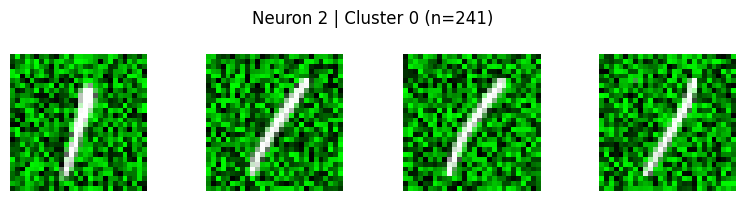

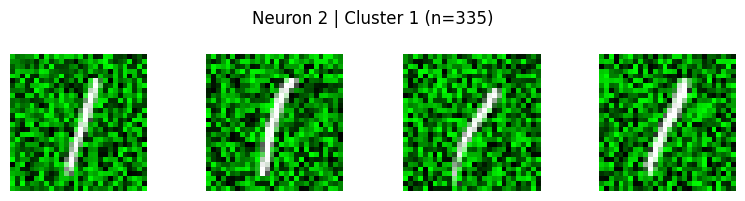

In [20]:
from sklearn.cluster import KMeans

def print_similarity_stats(embeddings):
    sim_matrix = embeddings @ embeddings.T
    print("shape:", sim_matrix.shape)
    print("min:", sim_matrix.min().item())
    print("mean:", sim_matrix.mean().item())
    print("max:", sim_matrix.max().item())

def show_kmeans_clusters(neuron, embeddings, n_clusters=3, per_cluster=4):

    kmeans = KMeans(n_clusters=n_clusters, random_state=100, n_init=10)
    labels = kmeans.fit_predict(embeddings.cpu().numpy())

    idxs = top_k_activations[neuron]
    imgs = x_train_colored[idxs]

    for c in range(n_clusters):
        c_idx = np.where(labels == c)[0]
        if len(c_idx) == 0:
            continue

        pick = c_idx[:per_cluster]
        fig, axes = plt.subplots(1, per_cluster, figsize=(8, 2))
        fig.suptitle(f"Neuron {neuron} | Cluster {c} (n={len(c_idx)})")
        for j, local_i in enumerate(pick):
            axes[j].imshow(imgs[local_i])
            axes[j].axis("off")
        plt.tight_layout()
        plt.show()

print_similarity_stats(embeddings)
show_kmeans_clusters(neuron=2, embeddings=embeddings, n_clusters=2, per_cluster=4)

Here, the mean of the similarity between the vectors is very high. This suggests that most of the images are considering basically the same thing. Now we can try to give a name to this direction; we'll have BLIP give human-like description of all the images that we trained on, and get the words with the highest frequency, and then use CLIP again to create text embeddings of sentences formed from those words and see how similar the image-embeddings are to that.

In [21]:
def load_blip():
    
    processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
    blip_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base").to(device)
    blip_model.eval()
    return processor, blip_model

blip_processor, blip_model = load_blip()

def caption_images(imgs_np, processor, model, batch_size=16, max_length=20):
    
    captions = []
    for i in range(0, len(imgs_np), batch_size):
        batch = imgs_np[i:i+batch_size]
        images = []
        for img in batch:
            img_uint8 = (img * 255).astype(np.uint8)
            images.append(Image.fromarray(img_uint8))

        inputs = processor(images, return_tensors="pt", padding=True).to(device)

        with torch.inference_mode():
            out = model.generate(**inputs, max_length=max_length)

        batch_captions = processor.batch_decode(
            out, skip_special_tokens=True
        )
        captions.extend(batch_captions)
    return captions

def get_topk_images_from_dataset(dataset, top_k_indices):
    imgs = []
    for idx in top_k_indices:
        img, _ = dataset[idx]
        imgs.append(img.permute(1, 2, 0).numpy())
    return np.stack(imgs)

def generate_captions(neuron):
    dataset = full_loader.dataset
    top_k_indices = top_k_activations[neuron]
    top_k_images = get_topk_images_from_dataset(dataset, top_k_indices)

    captions = caption_images(top_k_images, blip_processor, blip_model)
    for c in captions:
        print(c)
    return captions

captions = generate_captions(2)


The image processor of type `BlipImageProcessor` is now loaded as a fast processor by default, even if the model checkpoint was saved with a slow processor. This is a breaking change and may produce slightly different outputs. To continue using the slow processor, instantiate this class with `use_fast=False`. 


Loading weights:   0%|          | 0/473 [00:00<?, ?it/s]

The tied weights mapping and config for this model specifies to tie text_decoder.cls.predictions.bias to text_decoder.cls.predictions.decoder.bias, but both are present in the checkpoints, so we will NOT tie them. You should update the config with `tie_word_embeddings=False` to silence this warning
The tied weights mapping and config for this model specifies to tie text_decoder.bert.embeddings.word_embeddings.weight to text_decoder.cls.predictions.decoder.weight, but both are present in the checkpoints, so we will NOT tie them. You should update the config with `tie_word_embeddings=False` to silence this warning
BlipForConditionalGeneration LOAD REPORT from: Salesforce/blip-image-captioning-base
Key                                       | Status     |  | 
------------------------------------------+------------+--+-
text_decoder.bert.embeddings.position_ids | UNEXPECTED |  | 

Notes:
- UNEXPECTED	:can be ignored when loading from different task/architecture; not ok if you expect identic

a green screen with a white line on it
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white line
a green screen with a white line
a green background with a white line
a green screen with a white arrow
a green screen with a white line on it
a green screen with a white arrow
a green screen with a white line
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white line on it
a green screen with a white line on it
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white line on it
a green screen with a white arrow
a green screen with a white arrow
a green screen with a white arrow
a green background with a white line
a green screen with 

In [22]:
STOPWORDS = {
    "a", "the", "on", "in", "with", "and", "of", "to",
    "is", "this", "that", "an", "background"
}

def extract_keywords(captions, min_freq=3):
    words = []

    for cap in captions:
        cap = cap.lower()
        tokens = re.findall(r"[a-z0-9]+", cap)
        tokens = [t for t in tokens if t not in STOPWORDS]
        words.extend(tokens)

    counts = Counter(words)

    # keep frequent words
    keywords = {
        w: c for w, c in counts.items()
        if c >= min_freq
    }

    return dict(sorted(keywords.items(), key=lambda x: -x[1]))

keywords = extract_keywords(captions)
print(keywords)


{'green': 576, 'white': 576, 'screen': 514, 'arrow': 379, 'line': 192, 'it': 65, 'cross': 5}


In [23]:
candidate_labels = [
    "green screen with a white number 1 on it shaped like an arrow",
    "green",
    "white number"
]

def clip_text_scores(model, texts, image_embeddings):
    device = image_embeddings.device

    with torch.inference_mode():
        text_tokens = open_clip.tokenize(texts).to(device)
        text_embeddings = model.encode_text(text_tokens)
        text_embeddings = F.normalize(text_embeddings, dim=1)

    scores = {}
    for i, label in enumerate(texts):
        sims = image_embeddings @ text_embeddings[i]
        scores[label] = sims.mean().item()

    return scores

scores = clip_text_scores(clip_model, candidate_labels, embeddings)
for k, v in sorted(scores.items(), key=lambda x: -x[1]):
    print(f"{k:15s} : {v:.4f}")

green screen with a white number 1 on it shaped like an arrow : 0.2806
green           : 0.2647
white number    : 0.2306


That didn't work; I think that the vision encoder produces embeddings that are highly specific; also since the mean of the embeddings is very high, that means that they are pointing in a very specific direction. Since the vector space is 512-dimensional, it can be very hard to get a good match. Although, the input 'green screen with a white number 1 on it shaped like an arrow' had a noticable match with the embeddings as compared to the others, the similarity is still not very high.
So, something else we could do is instead of comparing it with human-interpretable text, we could compare it with 'visual snippets'. For example, I could compare it with just an entire 28x28x3 image of the background texture (in this case a textured greenish color), or just a plain black background with the number 1. Something else we could look at is an anti-color to green with the 1 still there, or just flat color. In the following example, I'll - 
 - Keep the background as textured green, but remove the number 1
 - Keep the number 1, and keep the background to be a textured red (which is kind of opposite to green) 

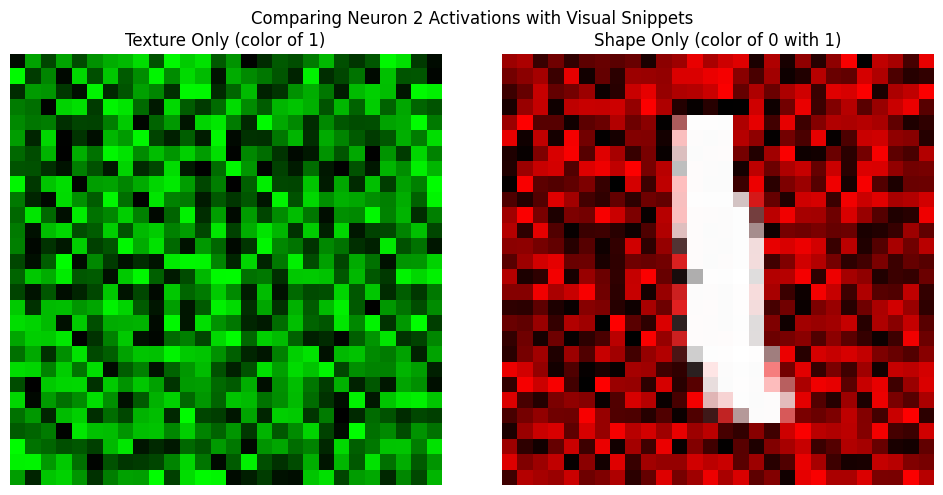

Similarity to Neuron 2:
Texture Only (color of 1): 0.9715
Shape Only (color of 0 with 1):   0.8943


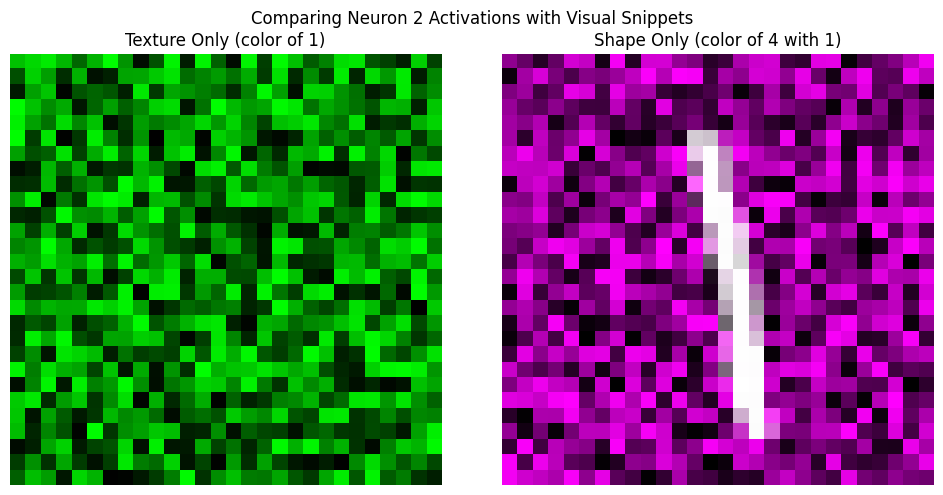

Similarity to Neuron 2:
Texture Only (color of 1): 0.9634
Shape Only (color of 4 with 1):   0.9466


In [24]:
def compare_with_visual_snippets(neuron, digit, anticolor):
    comparisons = []

    # doing the first option
    target_rgb = np.array(colors[digit])
    noise = np.random.rand(28, 28, 1)
    background = noise * target_rgb
    comparisons.append(background)
    # doing the second option
    mask_digit = (y_test == digit)
    mask_color = (y_test_colored == anticolor)
    blue_7 = x_test_colored[mask_digit & mask_color][0]
    comparisons.append(blue_7)

    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(comparisons[0])
    axes[0].set_title(f"Texture Only (color of {digit})")
    axes[0].axis('off')
    axes[1].imshow(comparisons[1])
    axes[1].set_title(f"Shape Only (color of {anticolor} with {digit})")
    axes[1].axis('off')
    plt.suptitle(f"Comparing Neuron {neuron} Activations with Visual Snippets")
    plt.tight_layout()
    plt.show()

    comparisons = np.stack(comparisons).astype(np.float32)

    with torch.inference_mode():
        imgs_clip = clip_batch_preprocessing(comparisons).to(next(clip_model.parameters()).device)

        comparison_embeddings = clip_model.encode_image(imgs_clip)

        comparison_embeddings = F.normalize(comparison_embeddings, dim=1)

    centroid = embeddings.mean(dim=0, keepdim=True)
    centroid = F.normalize(centroid, dim=1)

    sims = (comparison_embeddings @ centroid.T).squeeze().cpu().numpy()

    print(f"Similarity to Neuron {neuron}:")
    print(f"Texture Only (color of {digit}): {sims[0]:.4f}")
    print(f"Shape Only (color of {anticolor} with {digit}):   {sims[1]:.4f}")

    return comparisons

comparisons = compare_with_visual_snippets(2, 1, 0)
comparison_2 = compare_with_visual_snippets(2, 1, 4)

Here, the similarity of the texture is slightly closer to the mean of the top-k image vectors however not by much; both are reasonably close, though the neuron might be looking at texture slightly more than the actual shape of the digit.

In [25]:
def check_activation(neuron, comparisons):
    trained_model.eval()
    probe_tensor = torch.from_numpy(comparisons).permute(0, 3, 1, 2).float().to(device)
    with torch.inference_mode():
        activations = []
        def hook_fn(module, input, output):
            activations.append(output)
        handle = trained_model.gap.register_forward_hook(hook_fn)
        _ = trained_model(probe_tensor)
        handle.remove()
        neuron_activations = activations[0][:, neuron].flatten().cpu().numpy()

    print(f"ACTUAL Neuron {neuron} Activation:")
    print(f"Texture Only (color of 2, i.e. green): {neuron_activations[0]:.4f}")
    print(f"Shape Only (1):   {neuron_activations[1]:.4f}")

check_activation(2, comparisons)
check_activation(2, comparison_2)

ACTUAL Neuron 2 Activation:
Texture Only (color of 2, i.e. green): 3.2834
Shape Only (1):   2.2486
ACTUAL Neuron 2 Activation:
Texture Only (color of 2, i.e. green): 3.2743
Shape Only (1):   0.1366


The above suggests that while texture is not the only thing that neuron 2 looks at, since it got activated by a red 1 (which has no green component) the neuron also does not like to see blue (the activation decreased a lot when it saw magenta which has blue). Still, we can look into this further.

#### Method 1

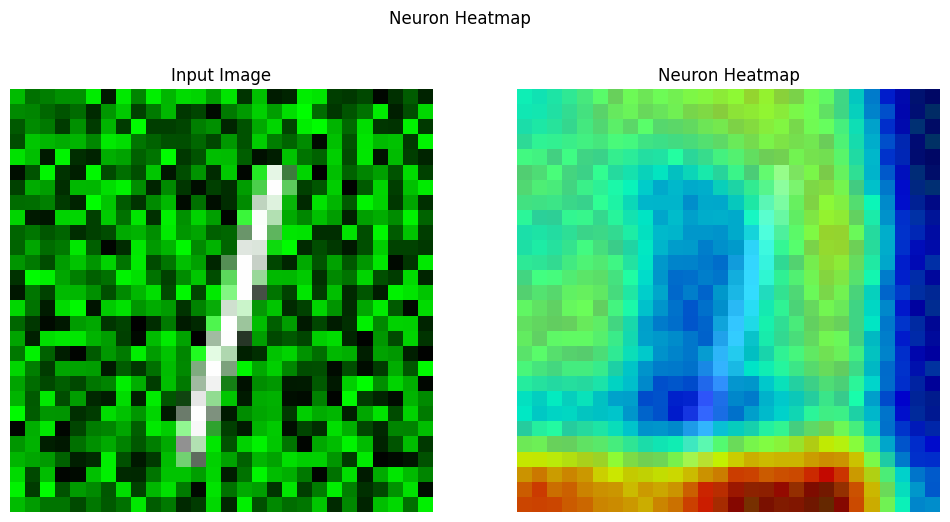

In [26]:
def plot_heatmap(img, heatmap, title, alpha):
    img = img.cpu().permute(1,2,0).numpy()
    heatmap_resized = cv2.resize(heatmap, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_CUBIC)
    if heatmap_resized.max() - heatmap_resized.min() > 1e-8:
        heatmap_norm = (heatmap_resized - heatmap_resized.min()) / (heatmap_resized.max() - heatmap_resized.min())
    else:
        heatmap_norm = np.zeros_like(heatmap_resized)
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    axes[0].imshow(img)
    axes[0].set_title("Input Image")
    axes[0].axis("off")
    axes[1].imshow(img) 
    axes[1].imshow(heatmap_norm, cmap="jet", alpha=alpha)
    axes[1].set_title("Neuron Heatmap")
    axes[1].axis("off")
    plt.suptitle(title)
    plt.show()

def get_neuron_heatmap(model, img, neuron):
    model.eval()
    
    activation = []
    def hook(module, input, output):
        activation.append(output.detach())
    hook_handle = model.c3.register_forward_hook(hook)
    with torch.inference_mode():
        _ = model(img.unsqueeze(0).to(device))
    hook_handle.remove()
    act = activation[0].squeeze().cpu().numpy()
    return act[neuron]

dataset = full_loader.dataset
img, _ = dataset[top_k_activations[2][0]]
heatmap = get_neuron_heatmap(trained_model, img, 2)
plot_heatmap(img, heatmap, "Neuron Heatmap", 0.8)

Here we can see that, for the neuron 2, the heatmap mainly focuses on the texture around the 1 (which is inline with some of our observations from before, about the model looking at the texture the most) and its also somewhat looking at the top part of the 1 (which explains the activation of the neuron based solely on color), however the main focus is still the texture. Now, let's try injecting the activation of the green texture into that of the activation a red 1, followed by a magenta 1, to see how much the class prediction changes; this will tell us about the relative importance that shape makes vs. texture makes to the neuron which then contributes greatly to the final decision the model makes.  

In [27]:
def inject_neuron(digit, color, neuron):
    mask_digit = (y_test == digit)
    mask_color = (y_test_colored == color)
    color_digit = x_test_colored[mask_digit & mask_color][0]
    color_digit_tensor = torch.from_numpy(color_digit).permute(2, 0, 1).unsqueeze(0).float().to(device)

    def patch_neuron_hook(module, input, output):
        patched_output = output.clone()
        patched_output[:, neuron] = 4 
        return patched_output

    trained_model.eval()
    with torch.inference_mode():
        logits_base = trained_model(color_digit_tensor)
        pred_base = logits_base.argmax().item()
        conf_base = F.softmax(logits_base, dim=1).max().item()

    handle = trained_model.gap.register_forward_hook(patch_neuron_hook)

    with torch.inference_mode():
        logits_patched = trained_model(color_digit_tensor)
        pred_patched = logits_patched.argmax().item()
        conf_patched = F.softmax(logits_patched, dim=1).max().item()

    handle.remove()

    print(f"Original Prediction (color of {color} with digit {digit}): Class {pred_base} ({conf_base:.2%})")
    print(f"Patched Prediction (Injected): Class {pred_patched} ({conf_patched:.2%})")

inject_neuron(1, 0, 2)
print("\ntest2:")
inject_neuron(1, 4, 2)

Original Prediction (color of 0 with digit 1): Class 0 (59.81%)
Patched Prediction (Injected): Class 0 (75.21%)

test2:
Original Prediction (color of 4 with digit 1): Class 4 (98.60%)
Patched Prediction (Injected): Class 4 (70.30%)


Here, it has actually increased the probability of the model predicting the digit 0 and in the 2nd test has decreased the probability of the digit 4; that is something that could be explained by looking at the linear layer of the model; we can see what the neuron actually contributes to.

Neuron 2's Voting Record:
Class 0: 1.1157
Class 1: 1.3844
Class 2: -0.4379
Class 3: 0.3209
Class 4: 0.3789
Class 5: -1.0571
Class 6: 0.6588
Class 7: -1.5707
Class 8: -0.7939
Class 9: 0.4576


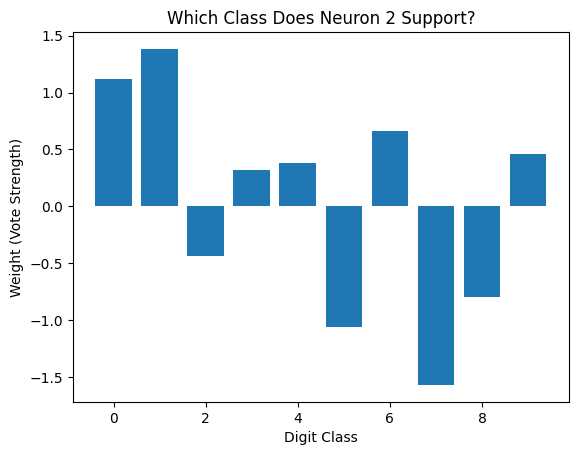

In [28]:
def neuron_weights(neuron_index):
    weights = trained_model.fc.weight.detach().cpu().numpy()
    neuron_votes = weights[:, neuron_index]
    print(f"Neuron {neuron_index}'s Voting Record:")
    for i, vote in enumerate(neuron_votes):
        print(f"Class {i}: {vote:.4f}")
    plt.bar(range(10), neuron_votes)
    plt.xlabel("Digit Class")
    plt.ylabel("Weight (Vote Strength)")
    plt.title(f"Which Class Does Neuron {neuron_index} Support?")
    plt.show()
    
neuron_weights(2)


This explains the action! It contributes very highly to both a class of 0 and the class of 1. However, more activation is given by 1 (and hence the frequency of 1s in the top activating images). However, this also kind of explains the correlation between 2 and 8, and also 2 and 13; 2 activates 6 as well, and there were a lot of 6s seen in the top activating images for 8 and 13. So this is in-line with our previous observations.
The conclusion for neuron 2 specifically is that it looks at both shape and texture (so it is polysemantic). It gets highly activated by a single closed loop (as seen by 0, 6 and 9) but the greatest activation happens when it sees the color 1's background texture. Also, it doesn't really like the color blue (seeing how the activation decreased when blue was introduced).

As an attempt to automate the process of deciphering a neuron, something we can do is run the 'activation with anti-color and digit' vs 'activation with just texture' test on all the neurons. That should be pretty informative about what each neuron actually looks for.

Running Counterfactual Ablation Test on Neurons...
Neuron 00 (Prefers 8): Texture=1.19 vs Shape=0.87 -> Texture (Color)
Neuron 01 (Prefers 6): Texture=0.00 vs Shape=0.00 -> Shape (Digit)
Neuron 02 (Prefers 1): Texture=3.32 vs Shape=0.14 -> Texture (Color)
Neuron 03 (Prefers 4): Texture=1.82 vs Shape=0.19 -> Texture (Color)
Neuron 04 (Prefers 2): Texture=0.99 vs Shape=0.77 -> Texture (Color)
Neuron 05 (Prefers 1): Texture=0.57 vs Shape=0.22 -> Texture (Color)
Neuron 06 (Prefers 3): Texture=0.15 vs Shape=0.31 -> Shape (Digit)
Neuron 07 (Prefers 3): Texture=0.00 vs Shape=1.99 -> Shape (Digit)
Neuron 08 (Prefers 1): Texture=3.32 vs Shape=0.00 -> Texture (Color)
Neuron 09 (Prefers 2): Texture=2.50 vs Shape=0.00 -> Texture (Color)
Neuron 10 (Prefers 3): Texture=3.94 vs Shape=0.03 -> Texture (Color)
Neuron 11 (Prefers 4): Texture=2.29 vs Shape=0.00 -> Texture (Color)
Neuron 12 (Prefers 1): Texture=0.00 vs Shape=2.77 -> Shape (Digit)
Neuron 13 (Prefers 7): Texture=0.00 vs Shape=0.41 -> Shape (

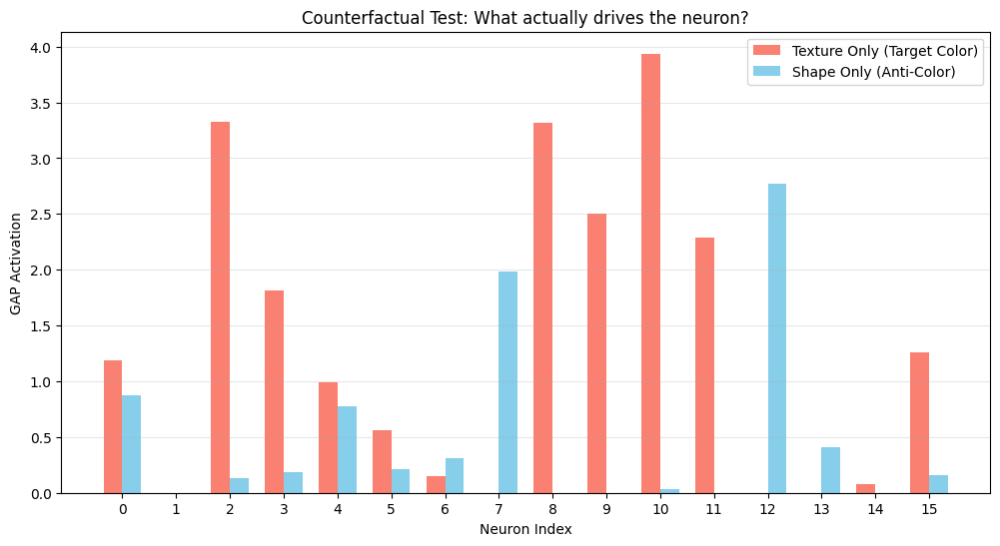

In [29]:
# --- Counterfactual Neuron Ablation Test (Updated for 10 Colors) ---

colors = {
    0: (1.0, 0.0, 0.0),      # Red
    1: (0.0, 1.0, 0.0),      # Green
    2: (0.0, 0.0, 1.0),      # Blue
    3: (1.0, 1.0, 0.0),      # Yellow
    4: (1.0, 0.0, 1.0),      # Magenta
    5: (0.0, 1.0, 1.0),      # Cyan
    6: (0.25, 1.0, 0.0),     # Lime Green
    7: (0.75, 0.25, 0.25),   # Muted Red
    8: (0.25, 0.75, 0.25),   # Muted Green
    9: (0.25, 0.25, 0.75)    # Muted Blue
}

def get_anti_color(class_idx):
    """
    Returns the RGB tuple of the high-contrast 'opposite' color.
    Manual mapping ensures maximum separation in RGB space.
    """
    complements = {
        0: (0.0, 1.0, 1.0),  # Red -> Cyan
        1: (1.0, 0.0, 1.0),  # Green -> Magenta
        2: (1.0, 1.0, 0.0),  # Blue -> Yellow
        3: (0.0, 0.0, 1.0),  # Yellow -> Blue
        4: (0.0, 1.0, 0.0),  # Magenta -> Green
        5: (1.0, 0.0, 0.0),  # Cyan -> Red
        6: (0.75, 0.0, 1.0), # Lime Green -> Purple (High Contrast)
        7: (0.25, 0.75, 0.75), # Muted Red -> Teal
        8: (0.75, 0.25, 0.75), # Muted Green -> Purple-ish
        9: (0.75, 0.75, 0.25)  # Muted Blue -> Yellow-ish
    }
    
    # Fallback to mathematical inversion if key missing
    if class_idx in complements:
        return np.array(complements[class_idx])
    return 1.0 - np.array(colors[class_idx])

def generate_ablation_pair(digit, colors, x_train_greyscale, y_train):
    """
    Generates two images:
    1. Texture Only: Pure background noise of the digit's associated color.
    2. Shape Only: The digit shape on an ANTI-color background.
    """
    # 1. Generate Texture Only (The "Color" Hypothesis)
    target_rgb = np.array(colors[digit])
    noise = np.random.rand(28, 28, 1)
    texture_img = noise * target_rgb
    
    # 2. Generate Shape Only (The "Digit" Hypothesis)
    # Find a real example of this digit
    # Note: We find the first instance where label == digit
    idx = np.where(y_train == digit)[0][0]
    digit_img = x_train_greyscale[idx] 
    
    # Extract the digit mask (assuming digit is white/light, bg is black/dark)
    # digit_img is HxWx3, taking channel 0 is sufficient for mask
    mask = digit_img[:, :, 0]
    mask_3c = np.stack([mask] * 3, axis=-1)
    
    # Create Anti-Color Background
    anti_rgb = get_anti_color(digit)
    bg_noise = np.random.rand(28, 28, 1)
    anti_bg = bg_noise * anti_rgb
    
    # Combine: Digit (White) on Anti-Color Background
    shape_img = ((1 - mask_3c) * anti_bg) + mask_3c
    
    return texture_img.astype(np.float32), shape_img.astype(np.float32)

def run_neuron_ablation_test(model, x_train_greyscale, y_train, colors):
    print("Running Counterfactual Ablation Test on Neurons...")
    
    # 1. Find preferred digit for each neuron (using the weights)
    fc_weights = model.fc.weight.detach().cpu().numpy() # Shape: (10, 16)
    preferred_digits = np.argmax(fc_weights, axis=0) # Shape: (16,)
    
    results = {'neuron': [], 'texture_act': [], 'shape_act': [], 'verdict': []}
    
    model.eval()
    
    for neuron_idx in range(16):
        digit = preferred_digits[neuron_idx]
        
        # Generate the pair
        tex_np, shp_np = generate_ablation_pair(digit, colors, x_train_greyscale, y_train)
        
        # Convert to tensor batch
        batch_np = np.stack([tex_np, shp_np])
        batch_t = torch.from_numpy(batch_np).permute(0, 3, 1, 2).float().to(device)
        
        # Get GAP activations
        with torch.no_grad():
            activations = []
            def hook(module, input, output):
                activations.append(output.detach().cpu())
            
            handle = model.gap.register_forward_hook(hook)
            _ = model(batch_t)
            handle.remove()
            
            # Extract the scalar activation for THIS neuron
            # activations[0] is shape (2, 16, 1, 1) -> [batch, neuron, 1, 1]
            acts = activations[0][:, neuron_idx, 0, 0].numpy()
            
        tex_act = acts[0]
        shp_act = acts[1]
        
        # Classify
        if tex_act > shp_act:
            verdict = "Texture (Color)"
        else:
            verdict = "Shape (Digit)"
            
        results['neuron'].append(neuron_idx)
        results['texture_act'].append(tex_act)
        results['shape_act'].append(shp_act)
        results['verdict'].append(verdict)
        
        print(f"Neuron {neuron_idx:02d} (Prefers {digit}): Texture={tex_act:.2f} vs Shape={shp_act:.2f} -> {verdict}")

    return results

# --- Plotting the Results ---
def plot_ablation_results(results):
    n = len(results['neuron'])
    indices = np.arange(n)
    width = 0.35
    
    plt.figure(figsize=(12, 6))
    plt.bar(indices - width/2, results['texture_act'], width, label='Texture Only (Target Color)', color='salmon')
    plt.bar(indices + width/2, results['shape_act'], width, label='Shape Only (Anti-Color)', color='skyblue')
    
    plt.xlabel('Neuron Index')
    plt.ylabel('GAP Activation')
    plt.title('Counterfactual Test: What actually drives the neuron?')
    plt.xticks(indices)
    plt.legend()
    plt.grid(axis='y', alpha=0.3)
    plt.show()

# Run it
ablation_results = run_neuron_ablation_test(trained_model, x_train_greyscale, y_train, colors)
plot_ablation_results(ablation_results)

This suggests that most of the images are actually looking at the texture of the image. We could check this by suppressing ones that look at color a lot (2, 8, 9, 10, 11) and see how the accuracy of the model changes on the test set.

In [30]:
def eval_with_gap_ablation(model, loader, neurons):
    model.eval()

    def ablation_hook(module, input, output):
        output = output.clone()
        output[:, neurons] = 0
        return output

    handle = model.gap.register_forward_hook(ablation_hook)
    acc, _, _ = test_model(model, loader)
    handle.remove()
    return acc

# Example: ablate neurons [2, 8, 9, 10, 11] on test set
ablated_acc = eval_with_gap_ablation(trained_model, test_loader, [2, 3, 8, 9, 10, 11, 15])
print(f"Ablated GAP accuracy: {ablated_acc:.4f}")


ablated_acc = eval_with_gap_ablation(trained_model, test_loader, [2, 3, 8, 9, 10, 11, 15, 12])
print(f"Ablated GAP accuracy with 12 removedd: {ablated_acc:.4f}")

Ablated GAP accuracy: 0.1422
Ablated GAP accuracy with 12 removedd: 0.1074


The results match. As we remove more and more neurons that 'contribute' to texture, the accuracy of the model on the test dataset increases (on removing 2, 3, 8, 9, 10, 11, 15, which are all the neurons that have a large difference between texture activation and shape activation, the accuracy went from 3% to 14%; which is better than randomly guessing). Also if we remove a neuron which contributes to the shape a lot (like 12) then the accuracy decreases again (it decreased by around 3%).

## Task - 3

### GRAD-CAM

This part will cover an implementation of GRAD-CAM

Predicted class for the input image is: 2


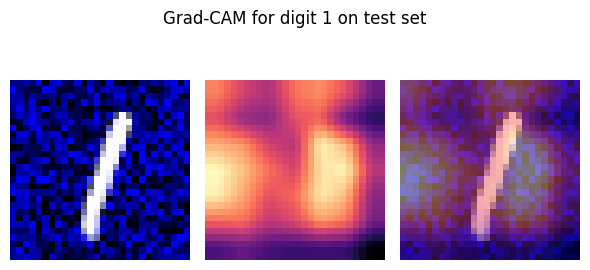

In [40]:
def get_gradcam(digit, dataset="train"):    
    # we have the code to hook into a layer defined previously
    activations = {}
    layer = trained_model.c3
    hook = layer.register_forward_hook(get_activations('c3', activations))


    # we need the gradients as well, so we need a backward hook
    gradients = {}
    def get_gradients(name, gradients):
        def hook(model, grad_in, grad_out):
            gradients[name] = grad_out[0]
        return hook

    grad_hook = layer.register_full_backward_hook(get_gradients('c3', gradients))
    # now we can pass an image through the model and get the activations at the layer, and also the probability distribtuion output of the model
    if (dataset == "train"):
        index = np.where((y_train == digit) & (y_train_colored == digit))[0][0]
        img = x_train_colored[index]
    elif (dataset == "btrain"):
        index = np.where((y_train == digit) & (y_train_colored != digit))[0][1]
        img = x_train_colored[index]
    else:
        index = np.where((y_test == digit) & (y_test_colored != digit))[0][1]
        img = x_test_colored[index]
    img_tensor = torch.from_numpy(img).permute(2, 0, 1).unsqueeze(0).float().to(device)
    out = trained_model(img_tensor)
    layer_activations = activations['c3'].detach().clone()
    predicted_class = torch.argmax(out, dim=1).item()
    print("Predicted class for the input image is:", predicted_class)


    # now we can do a backward pass from the predicted class to get the gradients at the layer
    trained_model.zero_grad()

    score = out[0, predicted_class]
    score.backward()

    A = activations['c3'].detach()
    grad = gradients['c3'].detach()
    weights = torch.mean(grad, dim=(2, 3), keepdim=True)
    cam = torch.sum(weights * A, dim=1)
    cam = torch.relu(cam)
    cam = cam.squeeze().cpu().numpy()

    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)
    cam = cv2.resize(cam, (28, 28))
    fig, axes = plt.subplots(1, 3, figsize=(6,3))
    axes[0].imshow(img)
    axes[0].axis("off")
    axes[1].axis("off")
    axes[1].imshow(cam, cmap='magma')
    axes[2].imshow(img)
    axes[2].imshow(cam, cmap='magma', alpha=0.5)
    axes[2].axis("off")
    plt.suptitle(f"Grad-CAM for digit {digit} on {dataset} set")
    plt.tight_layout()
    plt.show()
    hook.remove()
    grad_hook.remove()
    
get_gradcam(1, dataset="test")

Here, depending on the digit we want to see and the dataset we want it to be from we can get the GRAD-CAM for an image fitting the criteria. For example, here we have a 1 from the test dataset; it has 2's assigned background and that is what's predicted.

## Task - 4

### Model Correction


We can start with training the same model on the ground-truth dataset to see if it can accurately classify the digits for that.

In [32]:
# 1. Create Training Dataset
original_ds = TensorDataset(torch.from_numpy(x_train_greyscale).permute(0, 3, 1, 2).float(), torch.from_numpy(y_train).long())

# Split Training into Train/Val
total_len = len(original_ds)
gt_train_ds, gt_val_ds = random_split(
    original_ds, 
    [int(total_len * 0.8), int(total_len * 0.2)], 
    generator=torch.Generator().manual_seed(0)
)

gt_train_loader = DataLoader(gt_train_ds, batch_size=16, shuffle=True, generator=torch.Generator().manual_seed(0))
gt_val_loader = DataLoader(gt_val_ds, batch_size=16, shuffle=False)

# 3. Train and Test
gt_model, gt_history = train_model(
    epochs=10, 
    modelfunction=baseline_network, 
    train_loader=gt_train_loader, 
    val_loader=gt_val_loader
)

acc, _, _ = test_model(gt_model, original_test_loader)
print(f"Greyscale Accuracy: {acc:.4f}")

Trainable parameters: 1074
Epoch 1/10 | loss=1.3031 acc=0.5483 | val_loss=0.7132 val_acc=0.7792
Epoch 2/10 | loss=0.5663 acc=0.8263 | val_loss=0.4155 val_acc=0.8774
Epoch 3/10 | loss=0.4050 acc=0.8799 | val_loss=0.3505 val_acc=0.8949
Epoch 4/10 | loss=0.3461 acc=0.8954 | val_loss=0.3158 val_acc=0.9073
Epoch 5/10 | loss=0.3131 acc=0.9053 | val_loss=0.2724 val_acc=0.9207
Epoch 6/10 | loss=0.2874 acc=0.9142 | val_loss=0.2968 val_acc=0.9108
Epoch 7/10 | loss=0.2700 acc=0.9185 | val_loss=0.3134 val_acc=0.9061
Epoch 8/10 | loss=0.2565 acc=0.9234 | val_loss=0.2296 val_acc=0.9324
Epoch 9/10 | loss=0.2415 acc=0.9278 | val_loss=0.2302 val_acc=0.9311
Epoch 10/10 | loss=0.2280 acc=0.9323 | val_loss=0.2155 val_acc=0.9336
Model training complete!
Greyscale Accuracy: 0.9436


This verifies that our model architecture can reliably learn shapes. Now, we can fix the bias towards color.

In [33]:
fixed_ds = TensorDataset(torch.from_numpy(x_train_colored).permute(0, 3, 1, 2).float(), torch.from_numpy(y_train).long(), torch.from_numpy(y_train_colored).long())
fixed_train_ds, fixed_val_ds = random_split(fixed_ds, [int(len(fixed_ds) * 0.8), int(len(fixed_ds) * 0.2)], generator=torch.Generator().manual_seed(0))
fixed_train_loader = DataLoader(fixed_train_ds, batch_size=16, shuffle=True, generator=torch.Generator().manual_seed(0))
fixed_val_loader = DataLoader(fixed_val_ds, batch_size=16, shuffle=False)


class BaselineNetFixed(nn.Module):
    def __init__(self, has_color_head=True):
        super().__init__()
        self.c1 = conv_block(3, 4, 1, 2)
        self.p1 = nn.MaxPool2d(2)
        self.c2 = conv_block(4, 8, 1, 3)
        self.p2 = nn.MaxPool2d(2)
        self.c3 = conv_block(8, 16, 1, 2)
        self.gap = nn.AdaptiveAvgPool2d(1)
        
        self.fc_digit = nn.Linear(16, 10)
        self.fc_color = nn.Linear(16, 10) if has_color_head else None

    def get_features(self, x):
        x = self.p1(self.c1(x))
        x = self.p2(self.c2(x))
        x = self.c3(x)
        x = self.gap(x)
        return torch.flatten(x, 1)

    def forward(self, x):
        features = self.get_features(x)
        digit_logits = self.fc_digit(features)
        color_logits = self.fc_color(features) if self.fc_color else None
        return digit_logits, color_logits

def evaluate(model, loader, device, unpack_color=False):
    model.eval()
    correct, total = 0, 0
    with torch.no_grad():
        for batch in loader:
            if unpack_color:
                images, digit_labels, _ = batch
            else:
                images, digit_labels = batch
            images, digit_labels = images.to(device), digit_labels.to(device)
            
            output = model(images)
            if isinstance(output, tuple):
                logits = output[0]  # Take just the digit logits
            else:
                logits = output     # It's already just the logits

            correct += (logits.argmax(1) == digit_labels).sum().item()
            total += images.size(0)
            
    return correct / total

Both of the methods below rely on how a model performs on the biased dataset to identify which test-cases are 'hard', telling the model which should be focused on the most. That is the idea for JTT (Just Train Twice). The second method is based on K-Means clustering; we find the outliers in the dataset through the baseline model that we trained in task 1. Essentially, for a given digit d, we find all the images such that the digit is d. Then we group the GAP features into 2 groups based on how similar they are. The idea is that the larger one of these groups must correspond to images where background aligns with the digit learnt by the model (i.e. aligns with the model's bias), and the other smaller cluster corresponds to images where background does not align with the digit. Based on this we influence the images that the model sees.

#### Importance-based Reweighting of Inputs

In [34]:
def train_jtt(model_class, train_loader, test_loader_hard, device, num_epochs=20, up_weight=20.0):
    criterion = nn.CrossEntropyLoss(reduction="none")

    id_model = model_class().to(device)
    optimizer_id = optim.Adam(id_model.parameters(), lr=0.001)
    for _ in range(5):
        id_model.train()
        for images, digit_labels, _ in train_loader:
            images, digit_labels = images.to(device), digit_labels.to(device)
            optimizer_id.zero_grad()
            logits, _ = id_model(images)
            loss = criterion(logits, digit_labels).mean()
            loss.backward()
            optimizer_id.step()

    id_model.eval()
    dataset = train_loader.dataset
    error_mask = torch.zeros(len(dataset), dtype=torch.bool)

    full_loader = DataLoader(dataset, batch_size=256, shuffle=False)
    start = 0
    with torch.no_grad():
        for images, digit_labels, _ in full_loader:
            images, digit_labels = images.to(device), digit_labels.to(device)
            logits, _ = id_model(images)
            preds = logits.argmax(1)
            batch_err = preds != digit_labels
            error_mask[start:start + len(images)] = batch_err.cpu()
            start += len(images)

    final_model = model_class().to(device)
    optimizer_final = optim.Adam(final_model.parameters(), lr=0.001)

    weights = torch.ones(len(dataset))
    weights[error_mask] = up_weight
    sampler = torch.utils.data.WeightedRandomSampler(
        weights=weights, num_samples=len(weights), replacement=True
    )

    for epoch in range(num_epochs):
        final_model.train()
        train_correct = 0
        train_total = 0

        weighted_loader = DataLoader(dataset, batch_size=64, sampler=sampler)
        for images, digit_labels, _ in weighted_loader:
            images, digit_labels = images.to(device), digit_labels.to(device)
            optimizer_final.zero_grad()
            logits, _ = final_model(images)
            loss = criterion(logits, digit_labels).mean()
            loss.backward()
            optimizer_final.step()

            train_correct += (logits.argmax(1) == digit_labels).sum().item()
            train_total += images.size(0)

        train_acc = train_correct / max(train_total, 1)
        hard_acc = evaluate(final_model, test_loader_hard, device, unpack_color=False)
        print(f"Epoch {epoch+1:02d} | Train: {train_acc:.3f} | Hard Test: {hard_acc:.3f}")

    return final_model

jitt_model = train_jtt(BaselineNetFixed, fixed_train_loader, test_loader, device, num_epochs=20)

Epoch 01 | Train: 0.413 | Hard Test: 0.009
Epoch 02 | Train: 0.475 | Hard Test: 0.005
Epoch 03 | Train: 0.504 | Hard Test: 0.020
Epoch 04 | Train: 0.517 | Hard Test: 0.074
Epoch 05 | Train: 0.535 | Hard Test: 0.122
Epoch 06 | Train: 0.566 | Hard Test: 0.205
Epoch 07 | Train: 0.620 | Hard Test: 0.370
Epoch 08 | Train: 0.673 | Hard Test: 0.461
Epoch 09 | Train: 0.720 | Hard Test: 0.545
Epoch 10 | Train: 0.756 | Hard Test: 0.605
Epoch 11 | Train: 0.784 | Hard Test: 0.668
Epoch 12 | Train: 0.808 | Hard Test: 0.692
Epoch 13 | Train: 0.830 | Hard Test: 0.754
Epoch 14 | Train: 0.846 | Hard Test: 0.770
Epoch 15 | Train: 0.862 | Hard Test: 0.785
Epoch 16 | Train: 0.873 | Hard Test: 0.815
Epoch 17 | Train: 0.883 | Hard Test: 0.808
Epoch 18 | Train: 0.891 | Hard Test: 0.835
Epoch 19 | Train: 0.897 | Hard Test: 0.842
Epoch 20 | Train: 0.903 | Hard Test: 0.857


#### K-Means Clustering 

In [35]:
from sklearn.cluster import KMeans

def get_features_injected(self, x):
    x = self.p1(self.c1(x))
    x = self.p2(self.c2(x))
    x = self.c3(x)
    x = self.gap(x)
    return torch.flatten(x, 1)

# Attach it to the BaselineNet class
BaselineNet.get_features = get_features_injected

def get_unsupervised_weights(model, loader, device):
    print("Generating Weights via Unsupervised Clustering...")
    model.eval()
    
    # 1. Collect all features and labels
    all_features = []
    all_labels = []
    
    with torch.no_grad():
        for images, digit_labels, _ in loader:
            images = images.to(device)
            # Get features from the GAP layer (before the final classifier)
            feats = model.get_features(images) 
            all_features.append(feats.cpu().numpy())
            all_labels.append(digit_labels.cpu().numpy())
            
    all_features = np.concatenate(all_features)
    all_labels = np.concatenate(all_labels)
    
    # Initialize weights to 1.0
    weights = np.ones(len(all_labels))
    
    # 2. Cluster per class
    for digit in range(10):
        indices = np.where(all_labels == digit)[0]
        digit_features = all_features[indices]
        
        # Run K-Means with k=2 (Expected: Main Color vs Other Colors)
        kmeans = KMeans(n_clusters=2, random_state=42, n_init=10)
        clusters = kmeans.fit_predict(digit_features)
        
        # Identify which cluster is the "Minority" (Conflict)
        count_0 = (clusters == 0).sum()
        count_1 = (clusters == 1).sum()
        
        if count_0 < count_1:
            minority_cluster = 0
            minority_count = count_0
        else:
            minority_cluster = 1
            minority_count = count_1
            
        weight_val = min(20.0, len(indices) / (minority_count + 1e-5))
        
        global_indices_minority = indices[clusters == minority_cluster]
        weights[global_indices_minority] = weight_val
        
    print("Unsupervised Weighting Complete.")
    return torch.from_numpy(weights).float().to(device)

def train_clustering_ipw(model_class, train_loader, test_loader, weights, device, epochs=15):
    print("Method 2: Training with Unsupervised Cluster Weights...")
    
    model = model_class().to(device)
    optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.9)
    criterion = nn.CrossEntropyLoss(reduction='none') # Important: 'none' to weight samples
    
    for epoch in range(epochs):
        model.train()
        total_loss = 0

        sampler = torch.utils.data.WeightedRandomSampler(
            weights=weights,
            num_samples=len(weights),
            replacement=True
        )
        
        balanced_loader = DataLoader(
            train_loader.dataset,
            batch_size=64,
            sampler=sampler 
        )
        
        for images, labels, _ in balanced_loader: # Ignore color labels
            images, labels = images.to(device), labels.to(device)
            
            optimizer.zero_grad()
            logits = model(images)
            
            # Standard Loss (The sampler handles the weighting/balancing)
            loss = criterion(logits, labels).mean() 
            
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        # Evaluation
        acc = evaluate(model, test_loader, device, unpack_color=False)
        print(f"Epoch {epoch+1:02d} | Loss: {total_loss/len(balanced_loader):.4f} | Hard Test Acc: {acc:.4f}")
        
        if acc > 0.75:
            break
            
    return model

# --- EXECUTION ---

loader_for_clustering = DataLoader(fixed_train_loader.dataset, batch_size=256, shuffle=False)
cluster_weights = get_unsupervised_weights(trained_model, loader_for_clustering, device)
cluster_model = train_clustering_ipw(baseline_network, fixed_train_loader, test_loader, cluster_weights, device)

Generating Weights via Unsupervised Clustering...
Unsupervised Weighting Complete.
Method 2: Training with Unsupervised Cluster Weights...
Epoch 01 | Loss: 1.8720 | Hard Test Acc: 0.0189
Epoch 02 | Loss: 1.5306 | Hard Test Acc: 0.1520
Epoch 03 | Loss: 1.1179 | Hard Test Acc: 0.5026
Epoch 04 | Loss: 0.7476 | Hard Test Acc: 0.6364
Epoch 05 | Loss: 0.6061 | Hard Test Acc: 0.7035
Epoch 06 | Loss: 0.4994 | Hard Test Acc: 0.7553


## Task - 5


Running Targeted PGD Attack...
Original Prediction: 7
Adversarial Prediction: 3 (Confidence: 57.78%)
Max Noise Added: 0.0500 (Constraint: 0.05)


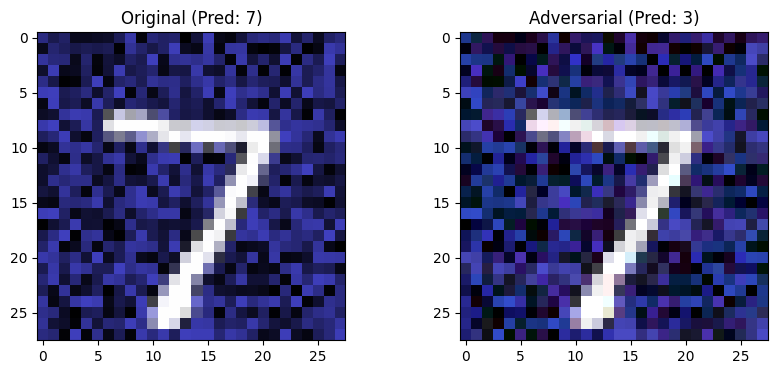

In [42]:
model = cluster_model
def targeted_pgd_attack(model, image, target_label, epsilon=0.05, alpha=0.01, num_steps=50):
    model.eval()
    
    perturbation = torch.zeros_like(image).to(device)
    perturbation.requires_grad = True
    
    target = torch.tensor([target_label]).to(device)
    criterion = nn.CrossEntropyLoss()

    for i in range(num_steps):
        output = model(torch.clamp(image + perturbation, 0, 1))
        
        if isinstance(output, tuple):
            logits = output[0]
        else:
            logits = output
            
        loss = criterion(logits, target)
        
        model.zero_grad()
        if perturbation.grad is not None:
            perturbation.grad.zero_()
            
        loss.backward()
        
        with torch.no_grad():
            grad_sign = perturbation.grad.sign()
            perturbation.data = perturbation.data - alpha * grad_sign
            perturbation.data = torch.clamp(perturbation.data, -epsilon, epsilon)
            perturbation.grad.zero_()
            
    final_adv_image = torch.clamp(image + perturbation, 0, 1).detach()
    return final_adv_image, perturbation.detach()

idx = np.where(y_test == 7)[0][0]
img_7 = torch.from_numpy(x_test_colored[idx]).permute(2, 0, 1).unsqueeze(0).float().to(device)

print("Running Targeted PGD Attack...")
adv_img, noise = targeted_pgd_attack(model, img_7, target_label=3, epsilon=0.05)

with torch.no_grad():
    pred_orig = model(img_7)
    if isinstance(pred_orig, tuple): pred_orig = pred_orig[0]
    pred_orig_cls = pred_orig.argmax().item()
    
    pred_adv = model(adv_img)
    if isinstance(pred_adv, tuple): pred_adv = pred_adv[0]
    pred_adv_cls = pred_adv.argmax().item()
    conf_adv = torch.softmax(pred_adv, dim=1).max().item()

print(f"Original Prediction: {pred_orig_cls}")
print(f"Adversarial Prediction: {pred_adv_cls} (Confidence: {conf_adv:.2%})")
print(f"Max Noise Added: {noise.abs().max().item():.4f} (Constraint: 0.05)")

# 4. Visualize
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 2, figsize=(10, 4))
ax[0].imshow(img_7.squeeze().permute(1, 2, 0).cpu().numpy())
ax[0].set_title(f"Original (Pred: {pred_orig_cls})")
ax[1].imshow(adv_img.squeeze().permute(1, 2, 0).cpu().numpy())
ax[1].set_title(f"Adversarial (Pred: {pred_adv_cls})")
plt.show()

## Additional Things

Below is code to run an estimation fot the local learning coefficient for the new model that we made; theoretically, it should be more complex (since it had to find a more complex solution than simply looking at the color of the background).

In [37]:
rlcts = estimate_rlcts(cluster_model, full_loader)
print("sgld: ", rlcts)

/home/vikeshkansal/College/Projects/precog_cv/.venv/lib/python3.10/site-packages/devinterp/slt/sampler.py:134: UserWarning: nbeta not set - using default nbeta.
  warnings.warn("nbeta not set - using default nbeta.")
/home/vikeshkansal/College/Projects/precog_cv/.venv/lib/python3.10/site-packages/devinterp/backends/default/slt/sampler.py:285: UserWarning: If you're setting a nbeta or temperature in optimizer_kwargs, please also make sure to set it in the callbacks.
  warnings.warn(


sgld:  {'llc/mean': 2.498443126678467, 'llc/std': 0.5597795844078064, 'llc-chain/0': 2.5554616451263428, 'llc-chain/1': 2.5861222743988037, 'llc-chain/2': 3.103830337524414, 'llc-chain/3': 1.7483583688735962, 'loss/trace': array([[0.8135392 , 0.32002857, 0.7663493 , ..., 0.48788634, 0.56871766,
        0.30954906],
       [1.2925578 , 0.4565846 , 0.92161024, ..., 0.9612414 , 1.1205443 ,
        0.38663495],
       [0.6899311 , 0.62485623, 0.85575217, ..., 1.2767221 , 1.4118707 ,
        0.46738252],
       [1.0699311 , 0.17224903, 1.089097  , ..., 0.45512247, 0.50861996,
        0.27554217]], shape=(4, 300), dtype=float32)}


Here the SGLD estimated LLC is around 2.46 which is almost double that of what our original, baseline model's was. This signifies that the new model that we have is a lot more complex than the baseline, and that is has actually learnt shape. one more thing that would be cool to see is how much the activation of the neurons in the model change (the automated algorithm we made in task-2).

Running Counterfactual Ablation Test on Neurons...
Neuron 00 (Prefers 2): Texture=1.07 vs Shape=0.81 -> Texture (Color)
Neuron 01 (Prefers 0): Texture=0.34 vs Shape=0.08 -> Texture (Color)
Neuron 02 (Prefers 2): Texture=0.50 vs Shape=0.31 -> Texture (Color)
Neuron 03 (Prefers 1): Texture=4.60 vs Shape=3.56 -> Texture (Color)
Neuron 04 (Prefers 4): Texture=3.18 vs Shape=3.09 -> Texture (Color)
Neuron 05 (Prefers 9): Texture=3.39 vs Shape=1.13 -> Texture (Color)
Neuron 06 (Prefers 1): Texture=0.91 vs Shape=0.28 -> Texture (Color)
Neuron 07 (Prefers 3): Texture=2.94 vs Shape=0.53 -> Texture (Color)
Neuron 08 (Prefers 4): Texture=0.65 vs Shape=0.45 -> Texture (Color)
Neuron 09 (Prefers 6): Texture=1.15 vs Shape=2.57 -> Shape (Digit)
Neuron 10 (Prefers 3): Texture=0.07 vs Shape=3.17 -> Shape (Digit)
Neuron 11 (Prefers 6): Texture=2.84 vs Shape=3.27 -> Shape (Digit)
Neuron 12 (Prefers 0): Texture=0.71 vs Shape=0.18 -> Texture (Color)
Neuron 13 (Prefers 8): Texture=3.80 vs Shape=3.18 -> Textu

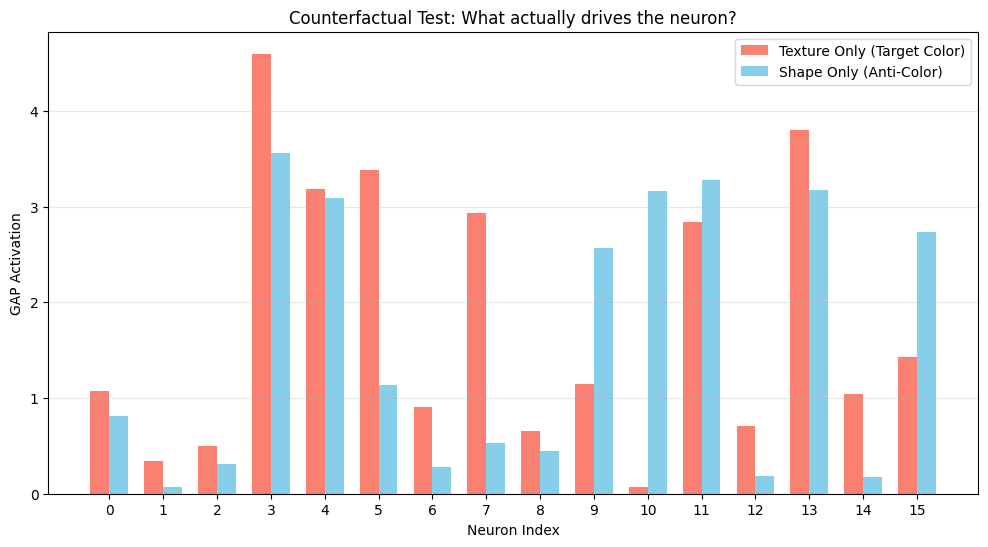

In [38]:
ablation_results = run_neuron_ablation_test(cluster_model, x_train_greyscale, y_train, colors)
plot_ablation_results(ablation_results)